In [1]:
import pdb
import copy
import math
from typing import Optional
from munch import Munch
import numpy as np
import time
import datetime
import torch
from torch.backends import cudnn
from core.data_loader import get_train_loader, get_test_loader, InputFetcher_LPFF, get_LPFF_loader
from torch import nn, Tensor
import torch.nn as nn
import torch.nn.functional as F
# visT
from PIL import Image
import pdb
import torchvision.transforms as transforms
from torch.cuda.amp import autocast
import torchvision.transforms.functional as Func
import matplotlib.pyplot as plt
import glob
import cv2
import TheMask as TM


/home/trinity/anaconda3/envs/swap38/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def normalize_by_127_5(img):
    """
    Normalize a tensor image by dividing by its maximum value.

    Args:
        img (torch.Tensor): Input image tensor.

    Returns:
        torch.Tensor: Normalized image tensor with values in [0, 1].
    """
    img = (img*255.0).int()
    return (img/127.5)-1.0  # Return unchanged if max is 0 (e.g., all-zero image)


def normalize_by_255(img):
    """
    Normalize a tensor image by dividing by its maximum value.

    Args:
        img (torch.Tensor): Input image tensor.

    Returns:
        torch.Tensor: Normalized image tensor with values in [0, 1].
    """
    return img/255  # Return unchanged if max is 0 (e.g., all-zero image)

def tensor2img(tensor):
    """
    Normalize a tensor image by dividing by its maximum value.

    Args:
        img (torch.Tensor): Input image tensor.

    Returns:
        torch.Tensor: Normalized image tensor with values in [0, 1].
    """
    return (tensor*255.0).int()  # Return unchanged if max is 0 (e.g., all-zero image)

def main():
    source_transform  = transforms.Compose([
         transforms.Resize((112,112)),
         transforms.ToTensor(),
         transforms.Lambda(normalize_by_127_5)
         ])
    
    TheMask = TM.build_models()
    TheMask.load('./save/MagicMask__eval')
    TheMask.cuda()
    TheMask.eval()
    
    #DPG.eval()
    #pdb.set_trace()
    src_image = Image.open('preprocessed_source_raw.png').convert('RGB')
    plt.imshow(src_image)
    plt.show()
    src_face = source_transform(src_image)

    loaders = Munch(src=get_LPFF_loader(root=['./dataset/LPFF_small/test_lpff'],
                                    img_size=128,
                                    batch_size=1,
                                    num_workers=1))
    
    test_fetcher = InputFetcher_LPFF(loaders.src, 'test')
    total_iters = 50
    time_list = []
    src_face = src_face.unsqueeze(0).cuda()
    for i in range(0, total_iters):
        inputs, src_img_path, tar_img_file = next(test_fetcher)
        src, tar, src_id, tar_id, src_lm, tar_lm, src_depth, tar_depth= inputs.src, inputs.tar, inputs.src_id, inputs.tar_id, inputs.src_lm, inputs.tar_lm,  inputs.src_depth, inputs.tar_depth

        start_time = time.time()
        vis1  = TheMask(tar, tar_depth, tar_lm, source_id_img=src_face)
        end_time = time.time()
        execution_time= end_time-start_time
        execution_time = execution_time*1000.0
        print('execution speed %.5f'%(execution_time))
        time_list.append(execution_time)
        
       
        tar= tar.detach().cpu().numpy().transpose(0, 2, 3, 1)[0]
        tar = (tar * 255).astype(int)
        #pdb.set_trace()
      
        
        tar_lm= tar_lm.detach().cpu().numpy().transpose(0, 2, 3, 1)[0]
        tar_lm = (tar_lm * 255).astype(int)
        
        tar_depth= tar_depth.detach().cpu().numpy().transpose(0, 2, 3, 1)[0]
        tar_depth = (tar_depth * 255).astype(int)

     
        vis1 = vis1[0].detach().cpu().numpy().transpose(0, 2, 3, 1)[0]
        vis1 = (vis1 * 255).astype(int)
        #pdb.set_trace()
        
        src_frame =  F.interpolate(src_face, size=(128, 128))
        src_frame = (src_frame.squeeze().permute(1,2,0).cpu().numpy()+1.0)*127.5
        #plt.figure()
        template = np.hstack((tar,tar_lm,tar_depth,src_frame,vis1))
        plt.imshow(tar)
        plt.show()
        plt.imshow(tar_lm)
        plt.show()
        plt.imshow(tar_depth)
        plt.show()
        plt.imshow(vis1)
        plt.show()
    print('average execution speed time: %f'%(np.mean(time_list)))


    
   
    

/home/trinity/Workspace/MagicMask/MagicMask_demo_code/TheMask.py:295: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  module_dict = torch.load('./arcface_w600k_r50_pytorch.pt'

Loading checkpoint from ./save/MagicMask__eval...


/home/trinity/Workspace/MagicMask/MagicMask_demo_code/TheMask.py:267: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.NV_module.load_state_dict(torch.load(PATH_NV))
/home

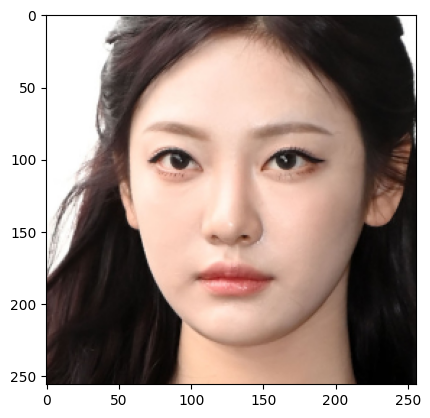

Preparing dataLoader to fetch images during the training phase...
./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 366.89234


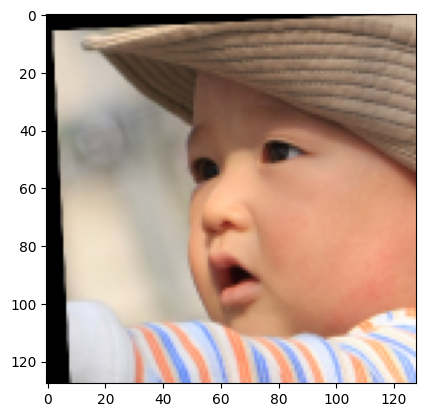

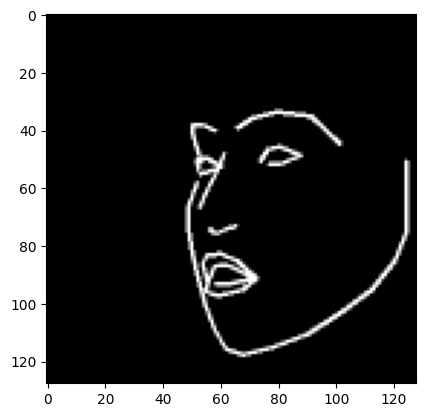

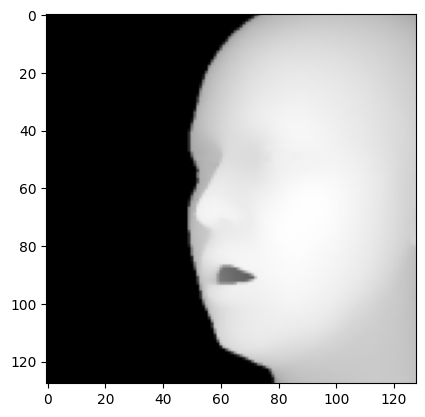

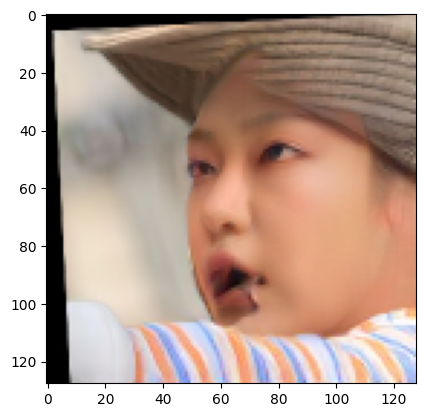

./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
execution speed 25.21420


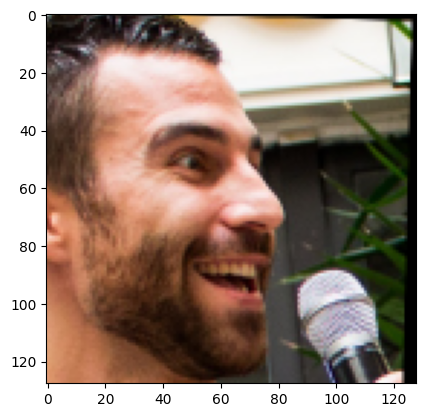

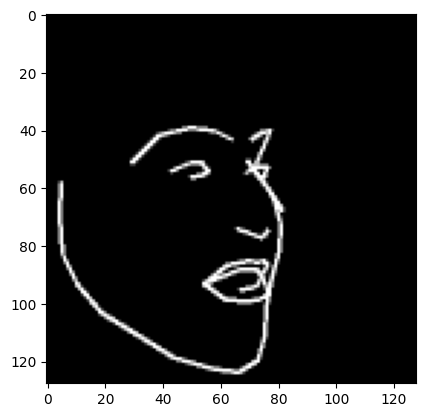

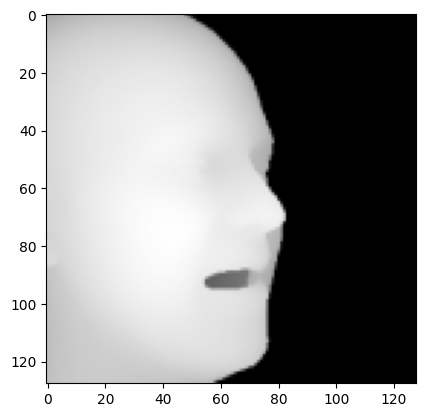

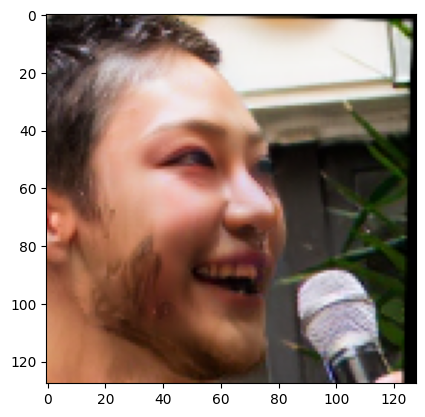

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 23.56577


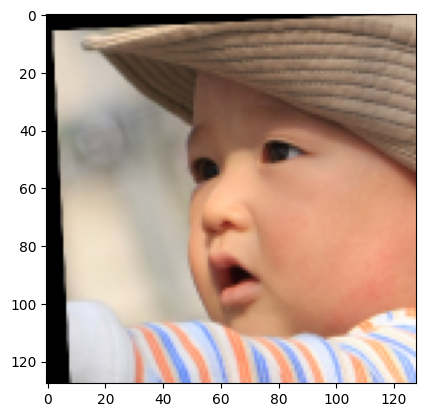

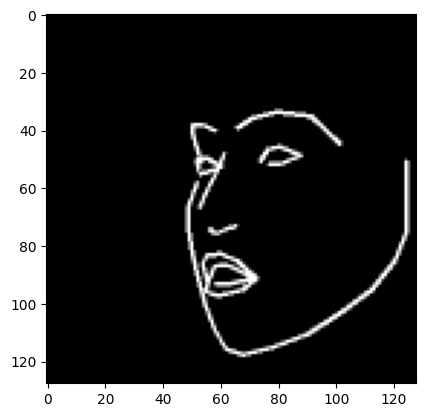

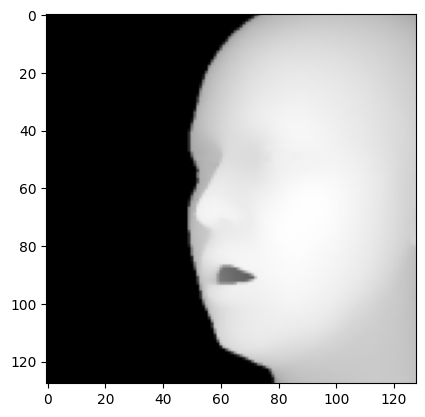

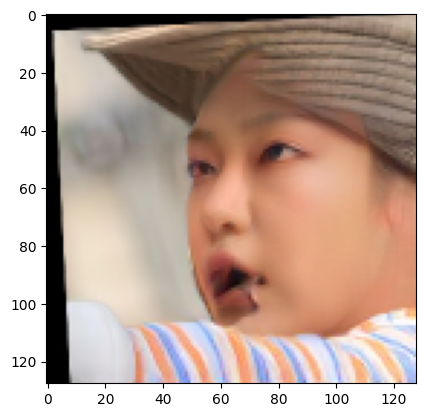

execution speed 17.26794


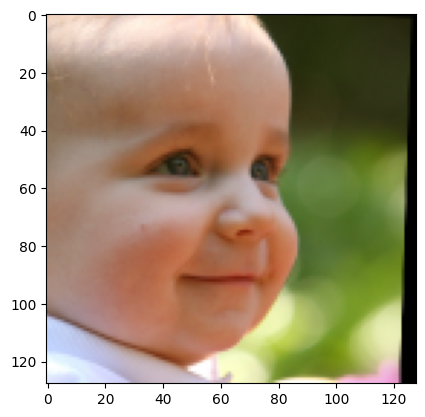

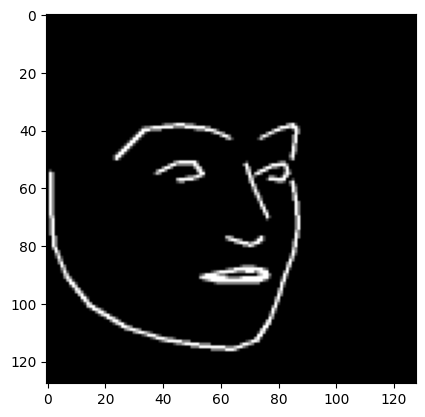

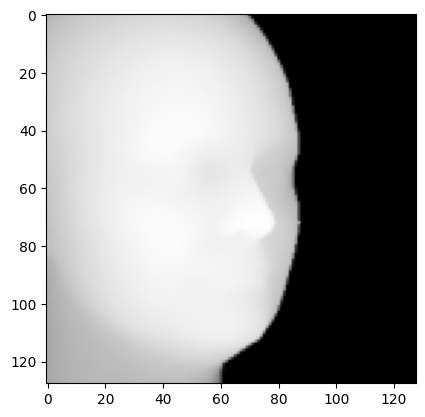

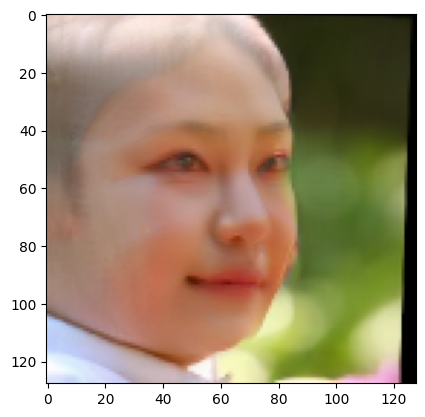

execution speed 21.99984


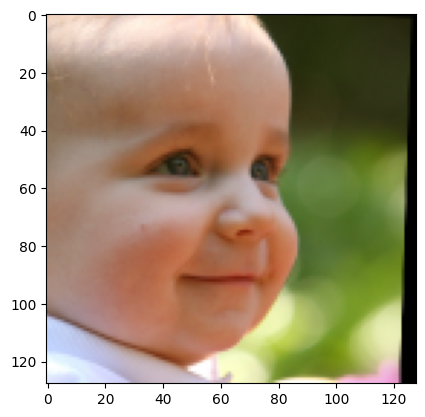

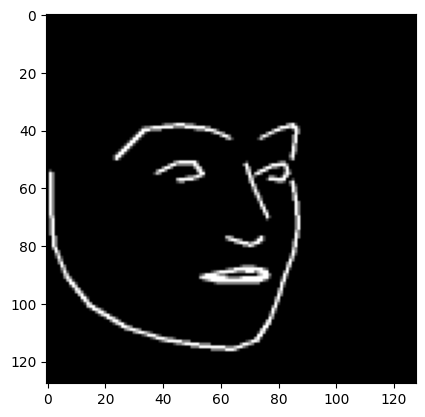

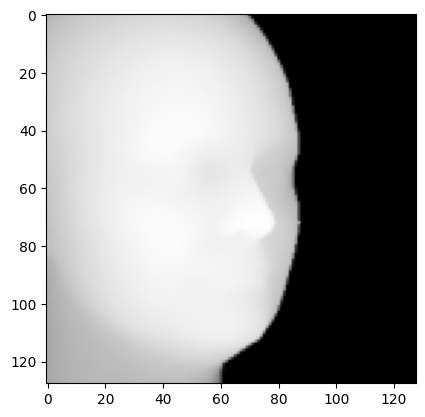

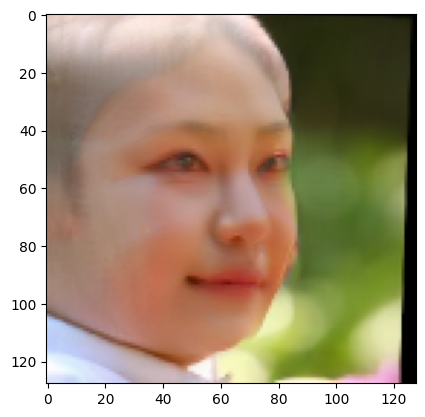

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
execution speed 32.85098


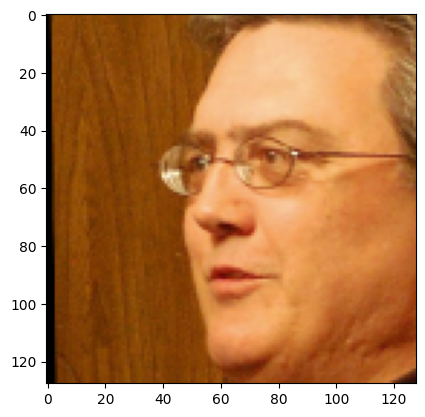

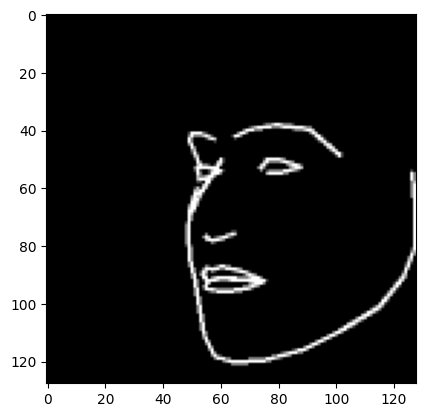

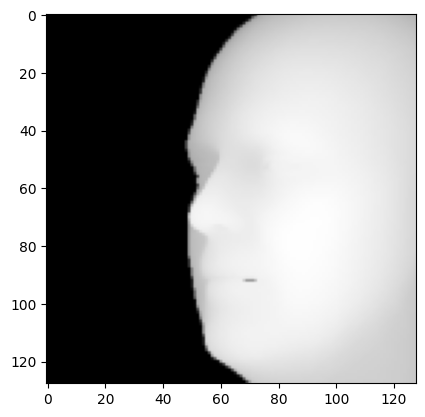

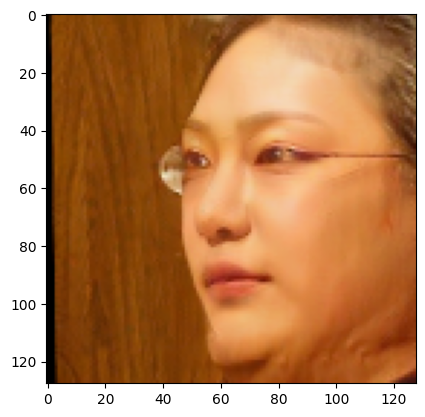

./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
execution speed 23.29373


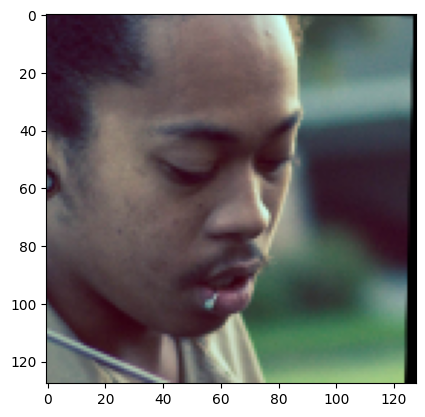

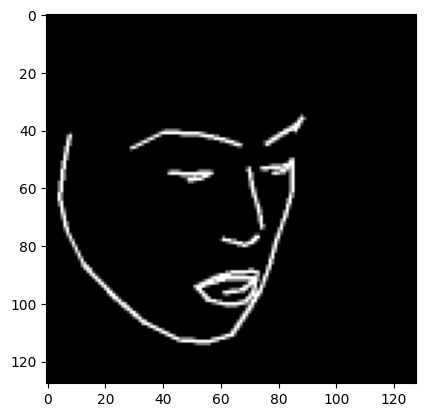

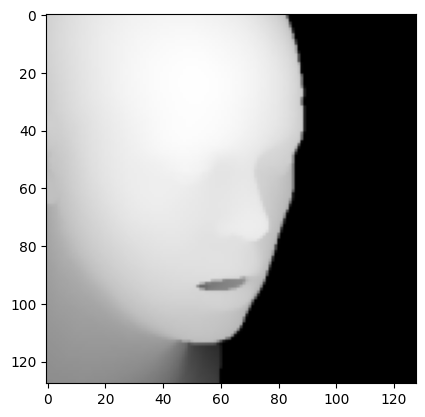

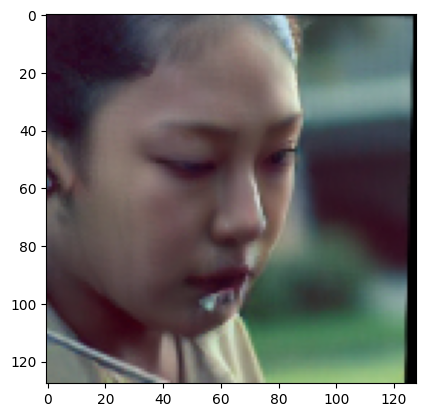

./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 23.39911


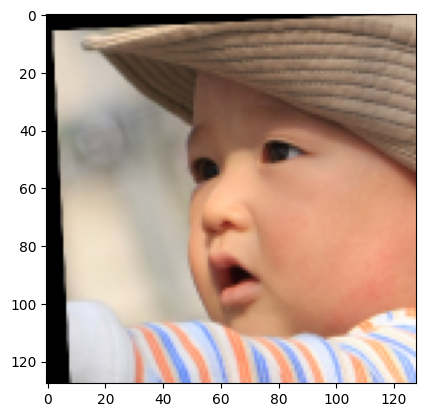

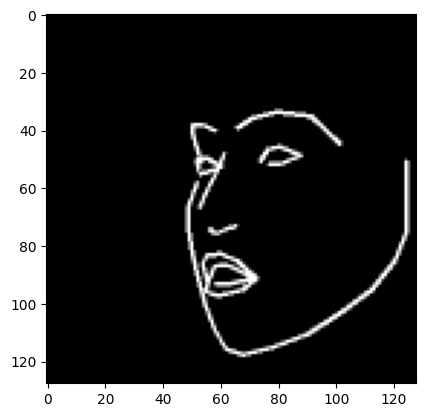

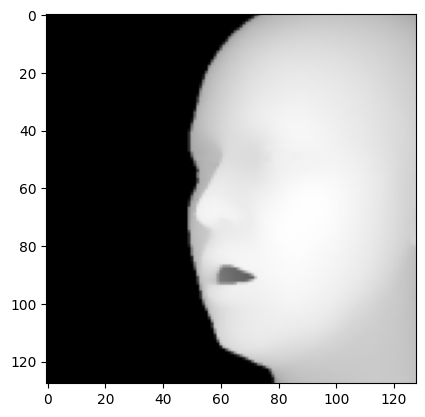

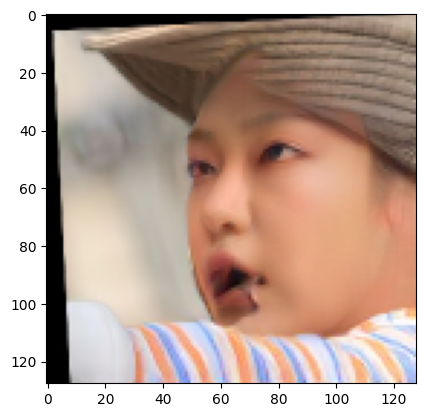

execution speed 17.34900


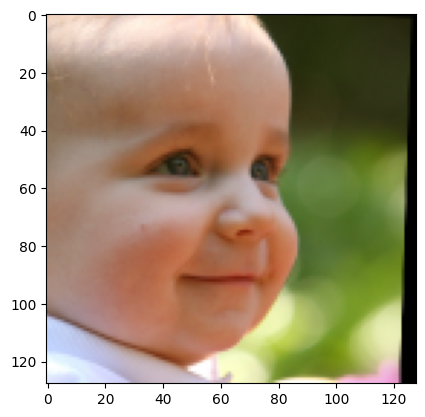

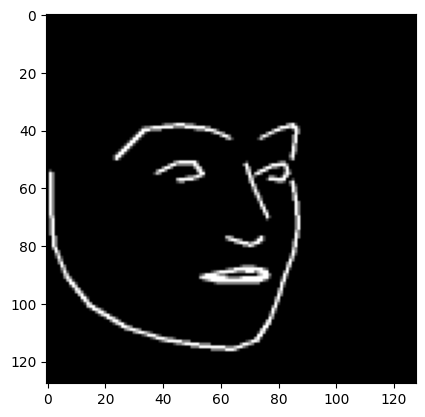

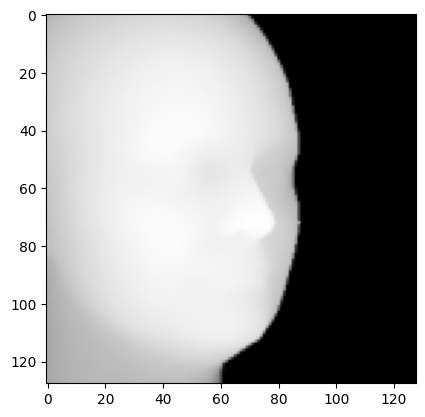

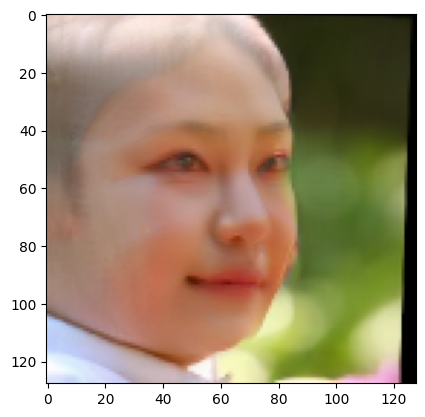

execution speed 20.42365


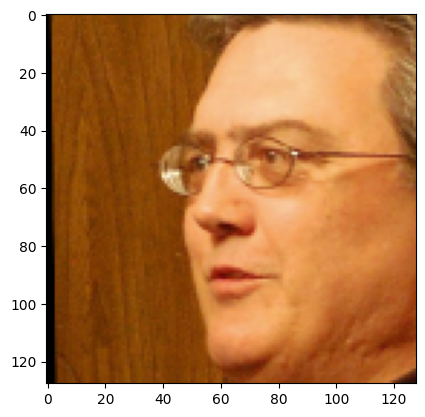

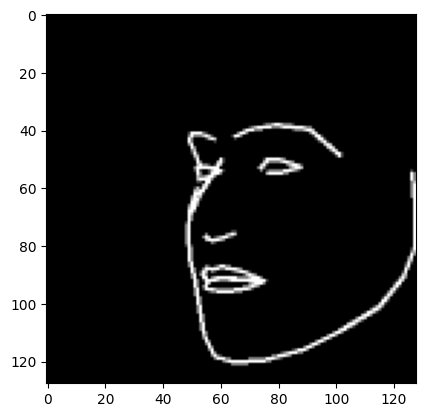

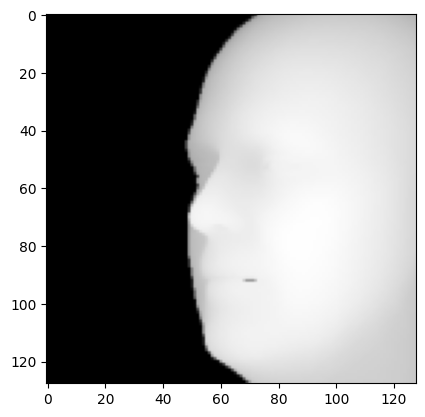

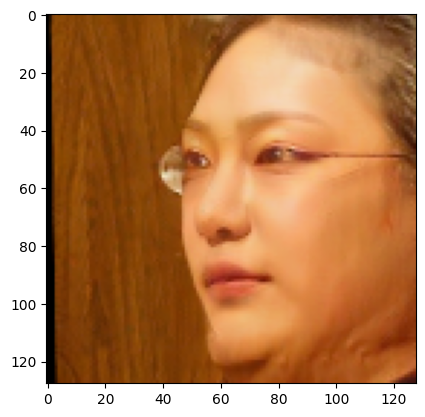

./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
execution speed 30.72882


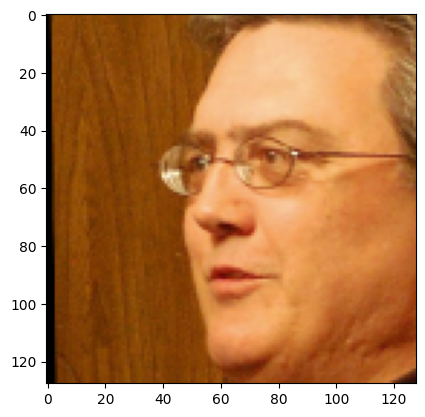

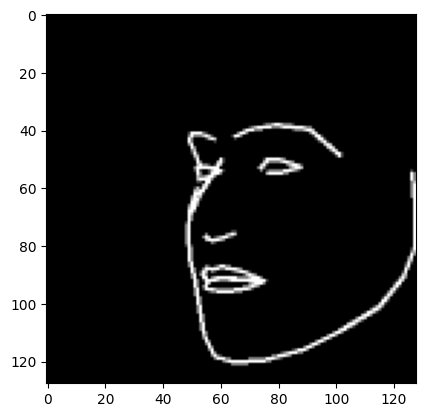

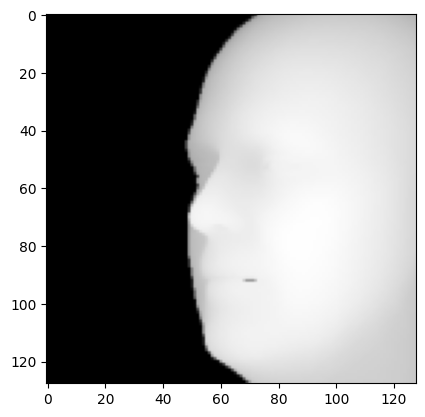

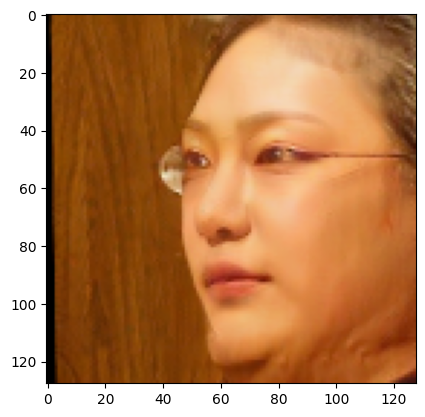

./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
execution speed 23.85378


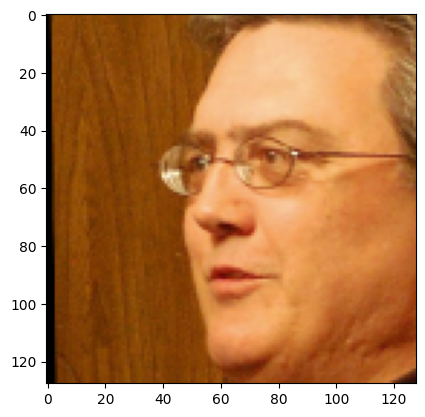

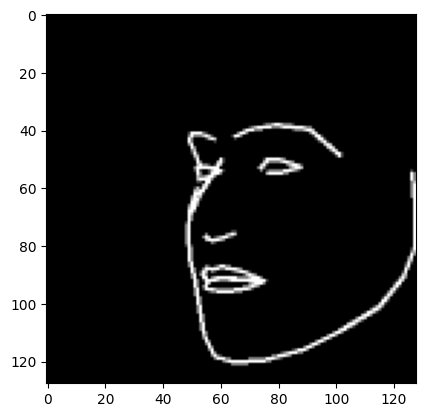

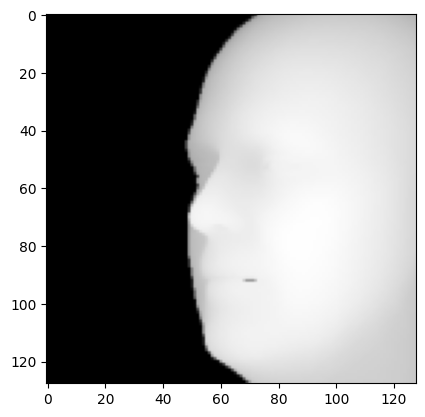

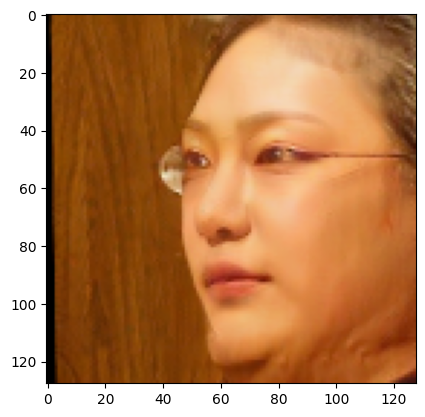

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 21.79027


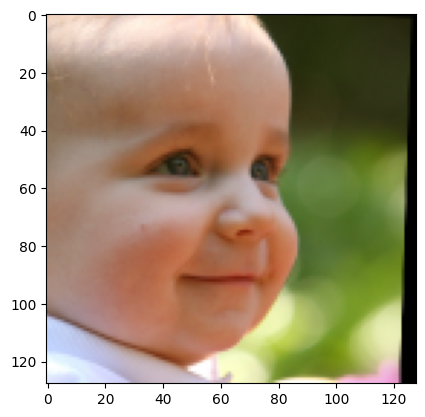

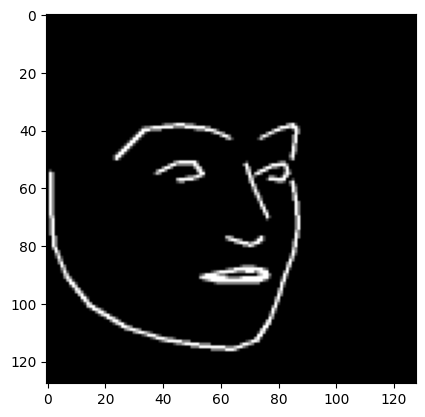

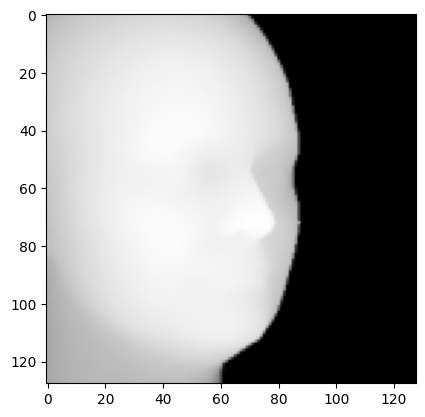

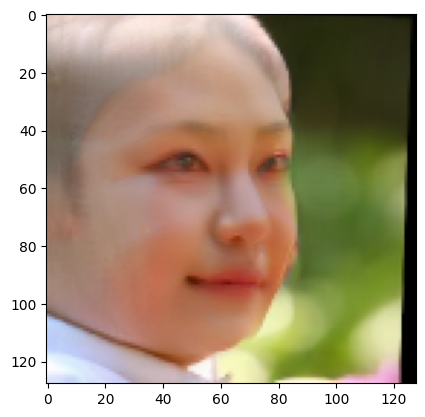

execution speed 19.44065


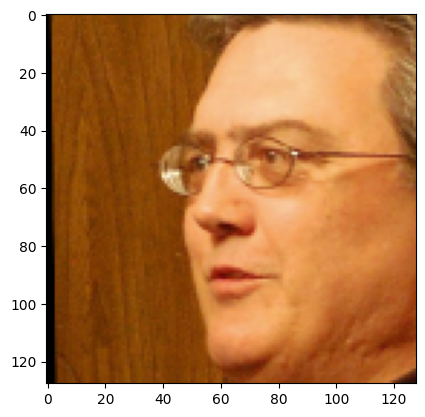

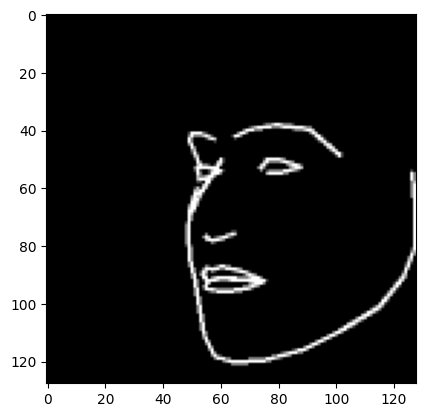

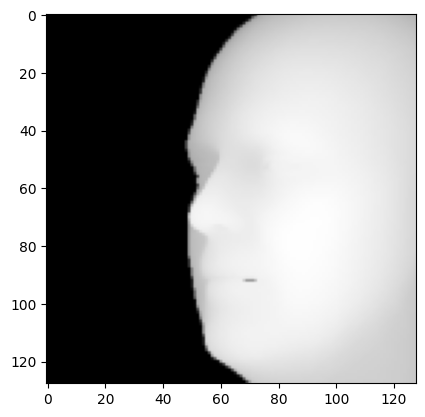

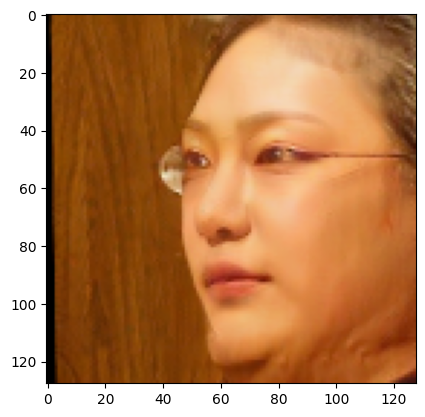

execution speed 21.89898


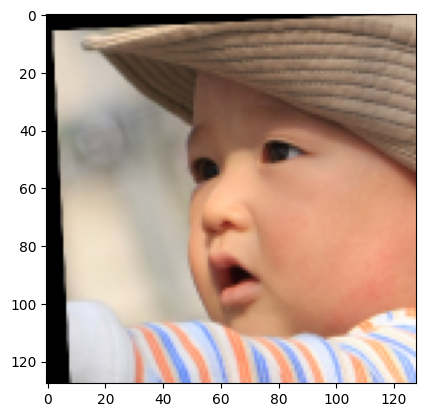

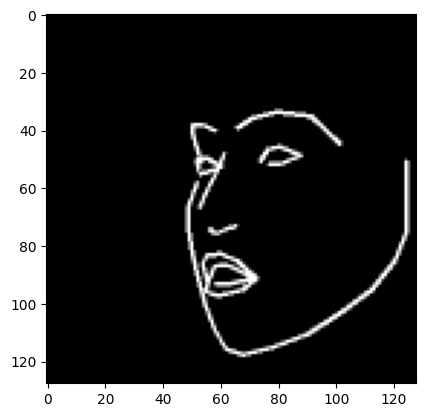

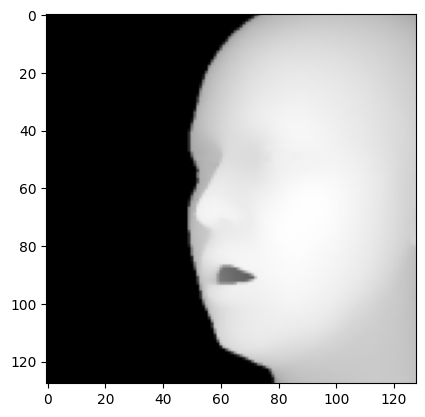

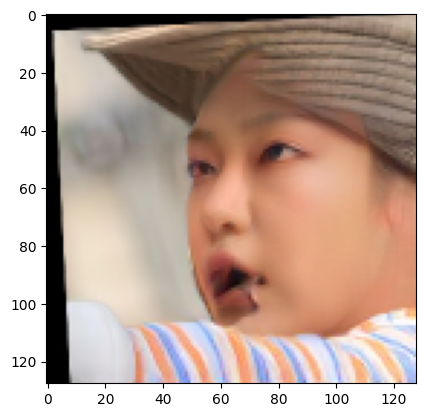

./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 31.48007


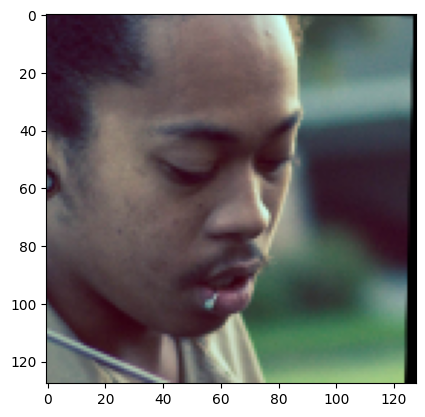

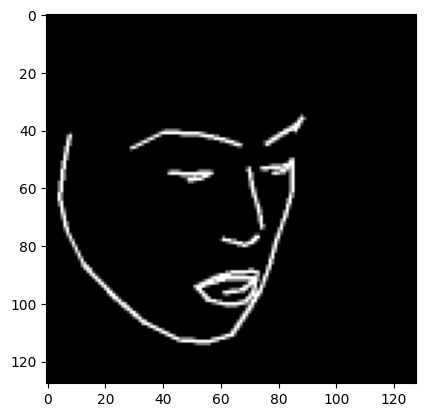

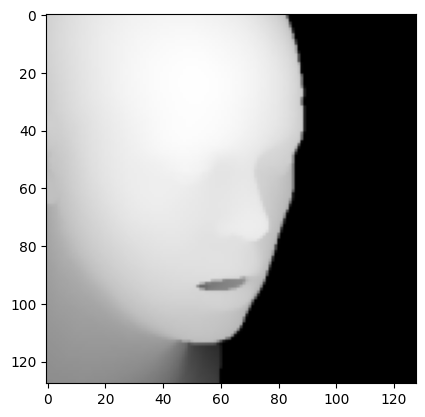

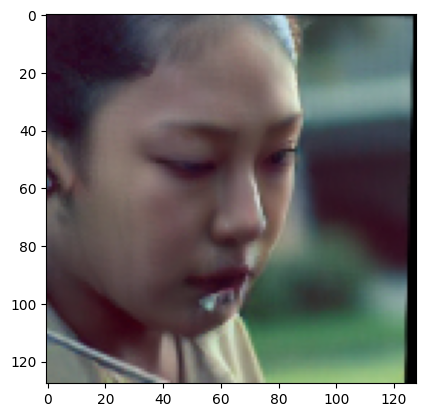

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 21.79456


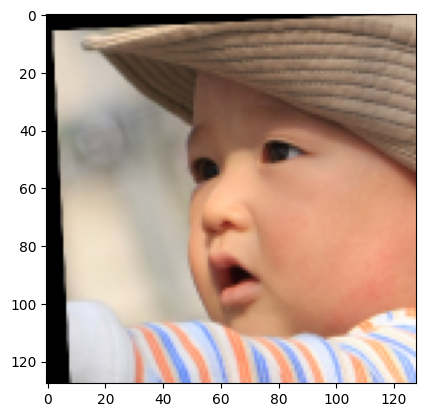

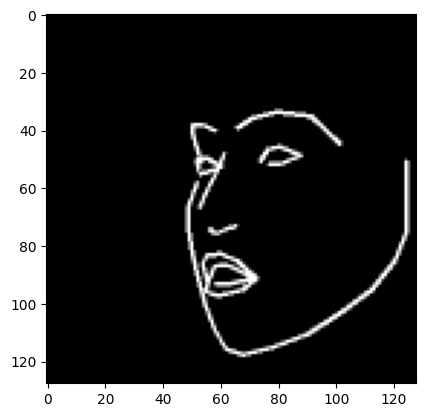

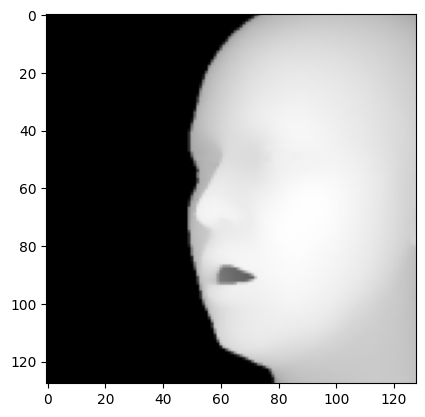

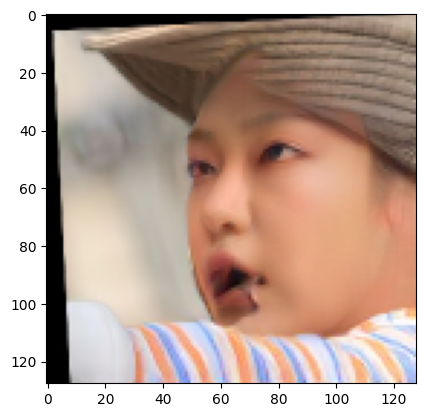

./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
execution speed 23.32973


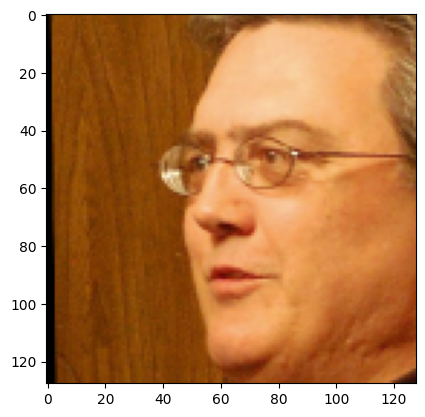

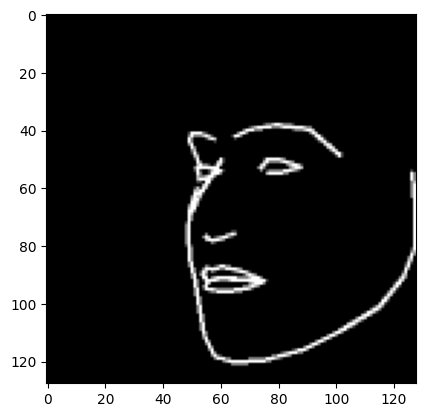

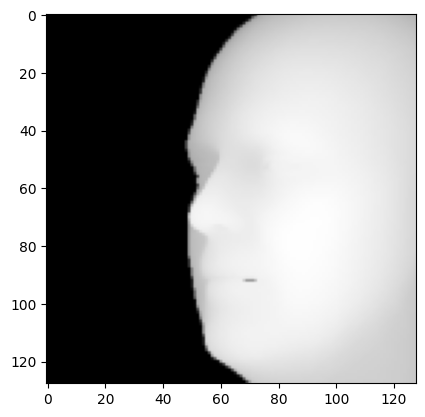

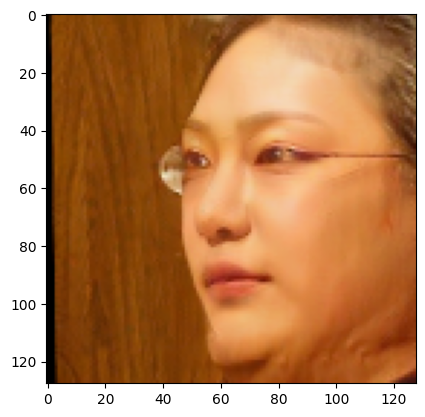

execution speed 20.30587


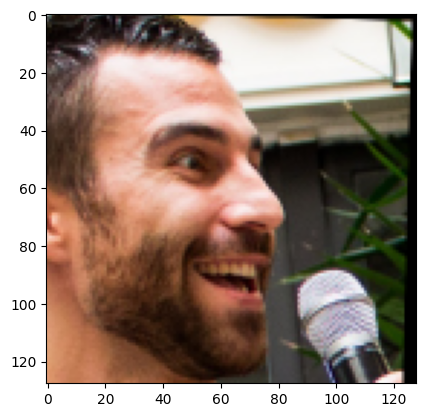

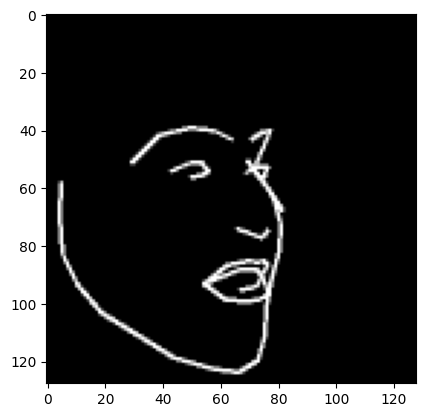

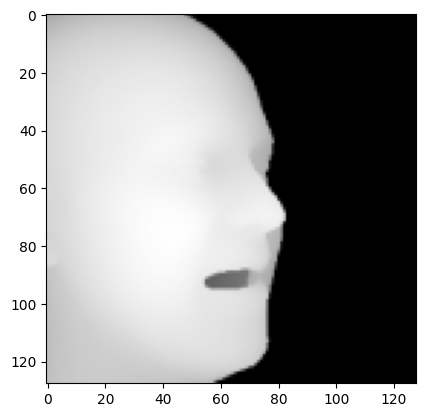

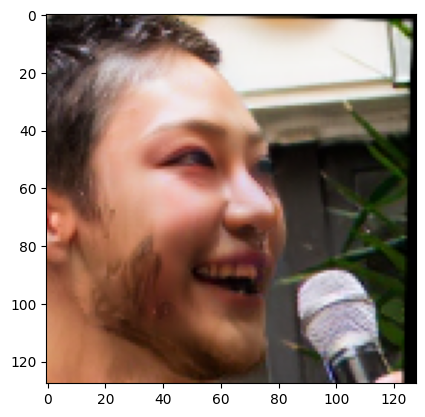

execution speed 17.65299


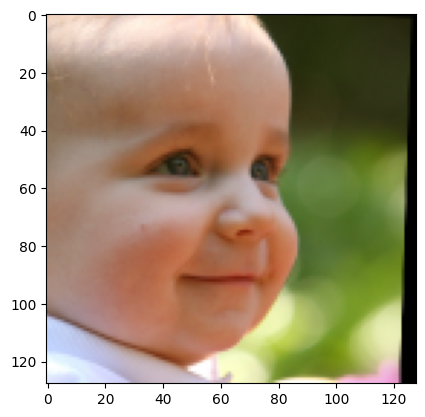

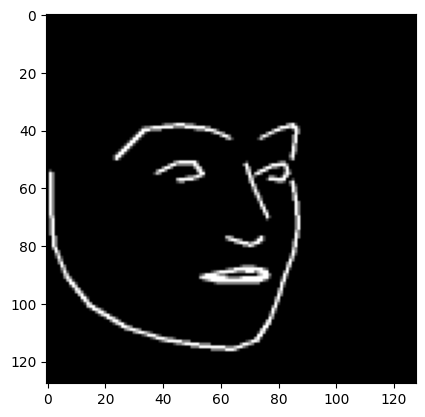

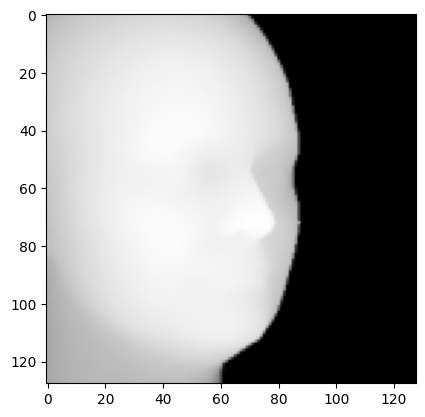

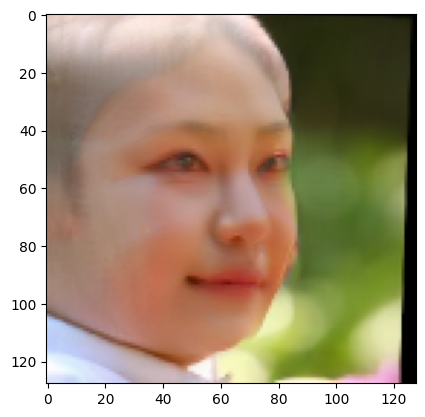

./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
execution speed 34.95288


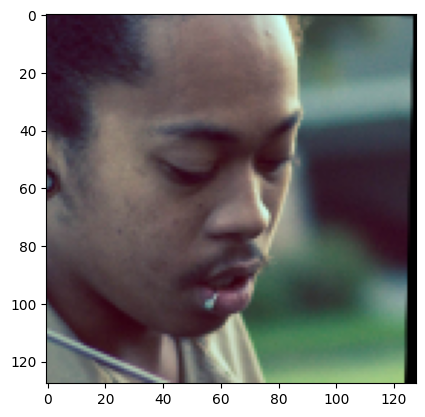

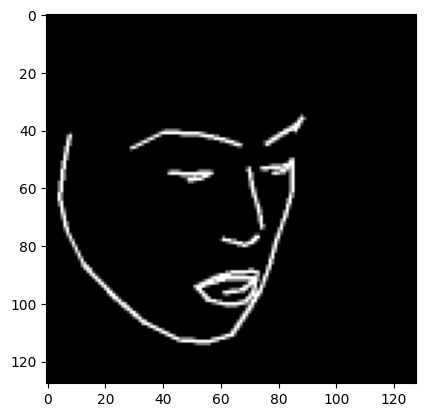

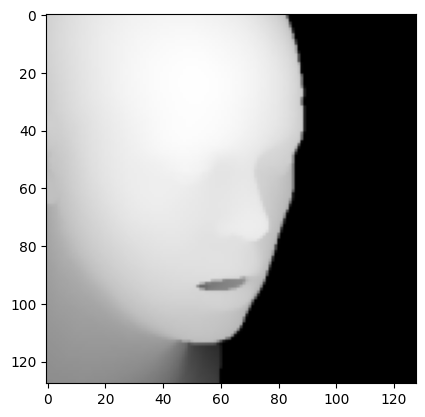

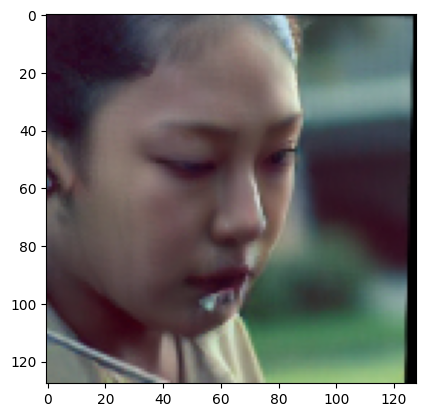

./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 23.48757


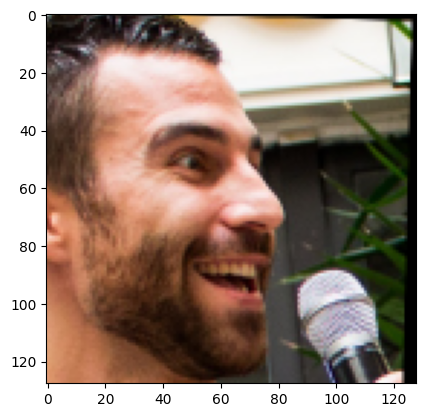

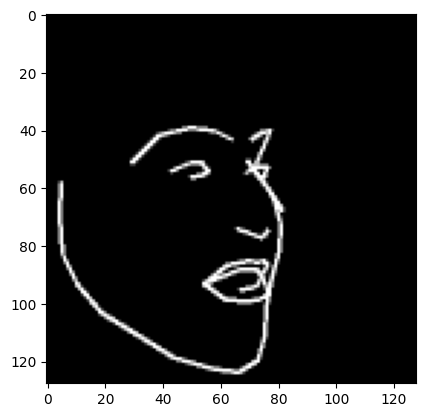

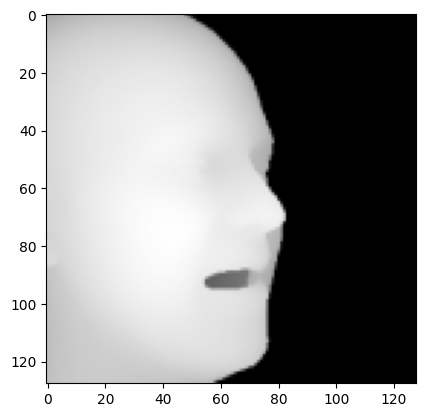

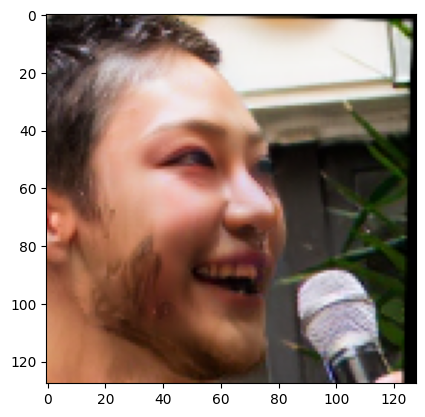

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 25.52462


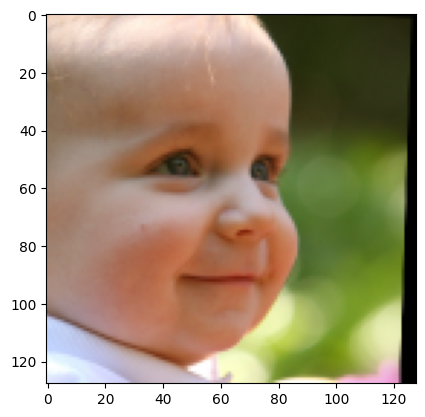

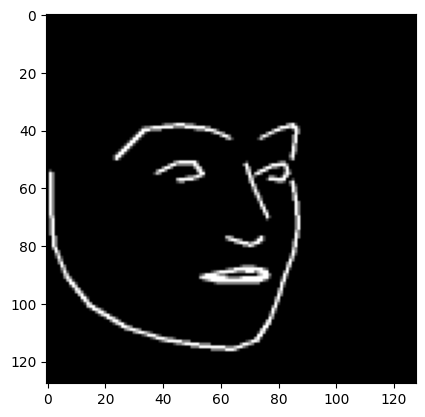

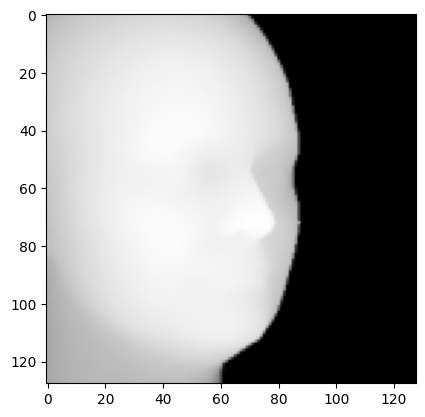

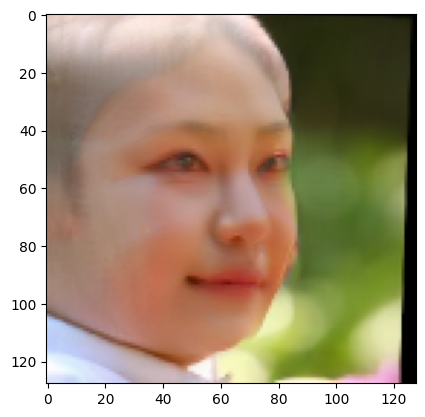

execution speed 18.03493


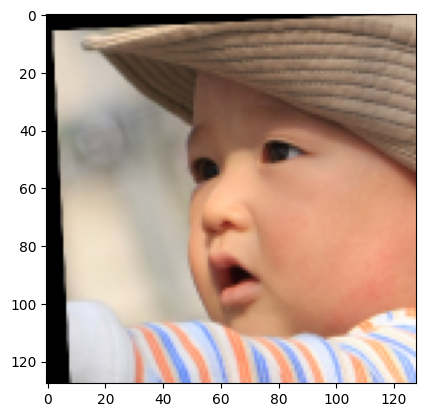

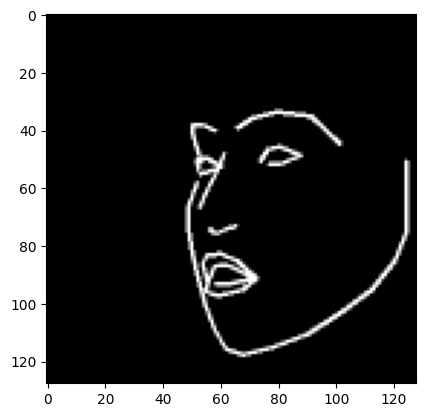

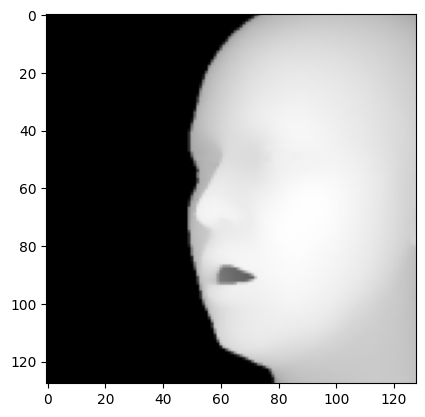

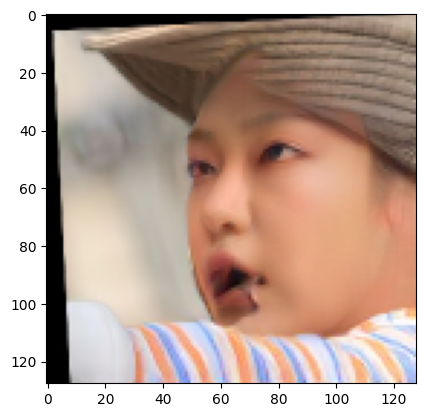

execution speed 23.20361


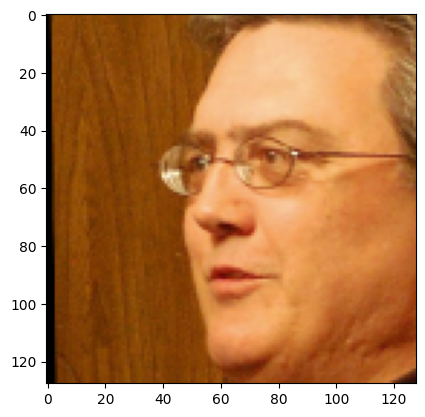

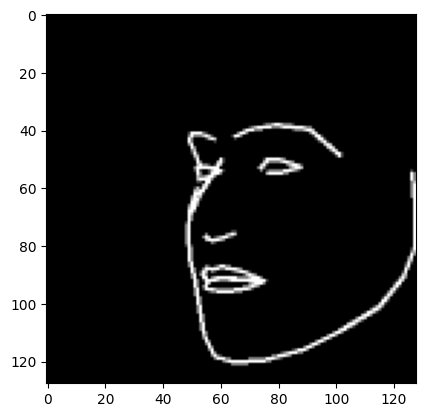

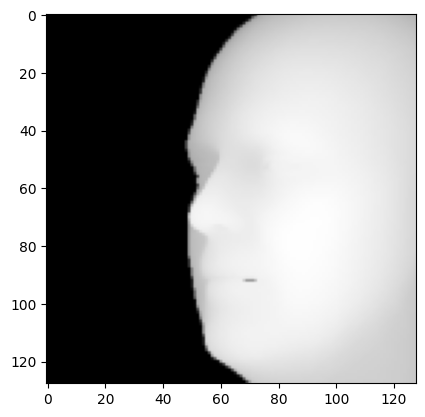

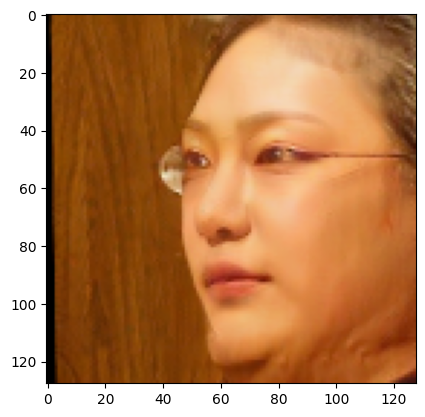

./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 33.30827


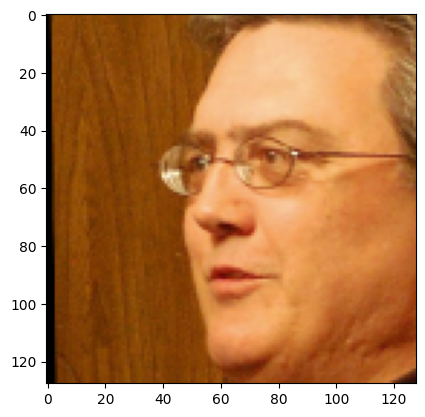

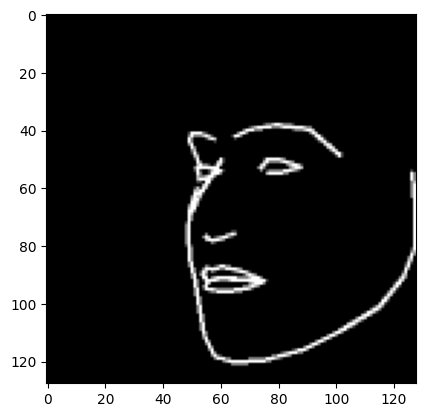

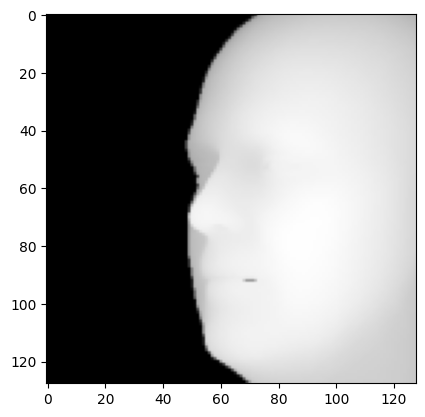

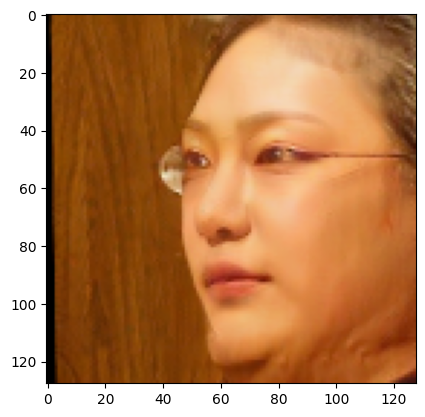

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 23.12827


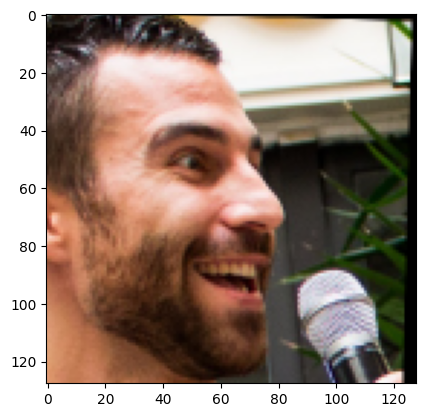

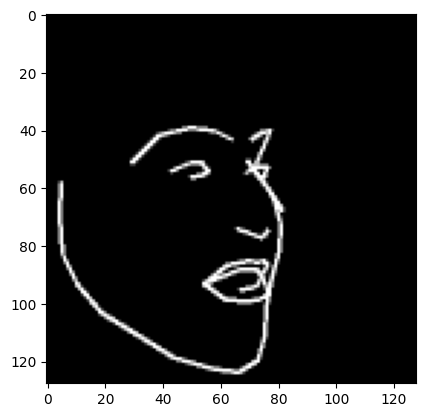

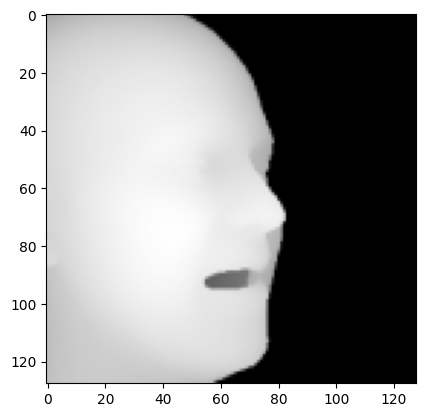

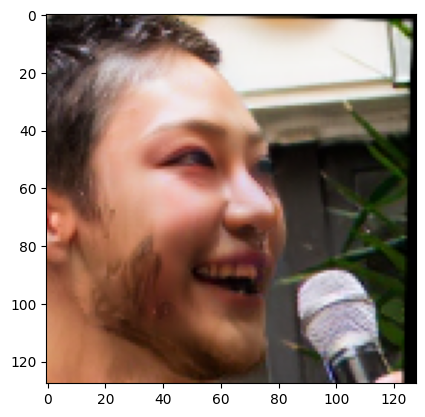

./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
execution speed 22.64929


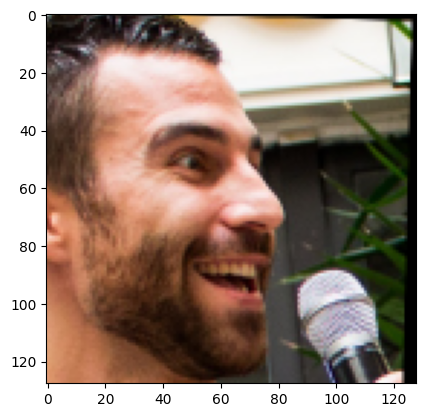

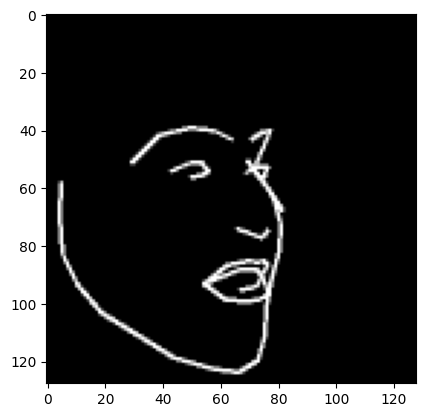

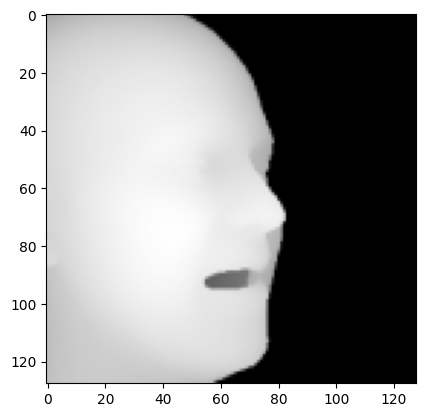

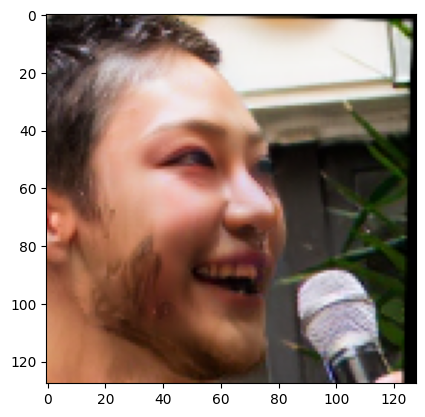

execution speed 17.86685


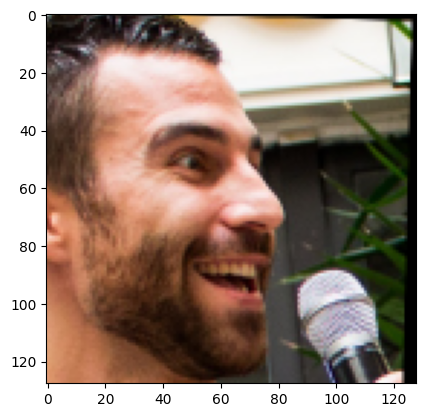

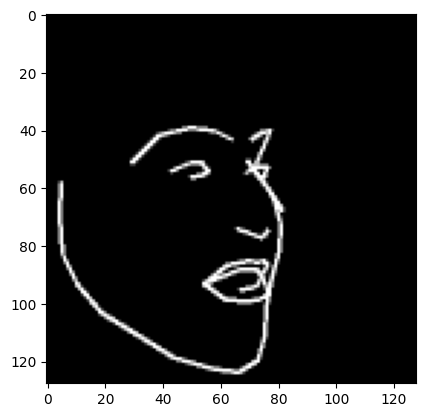

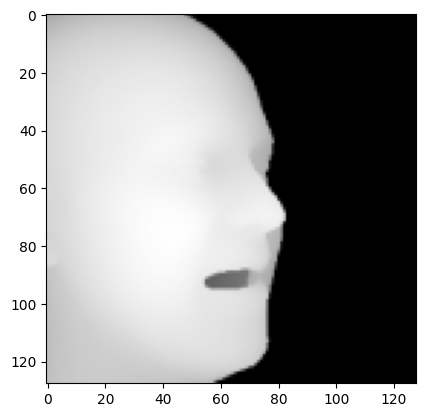

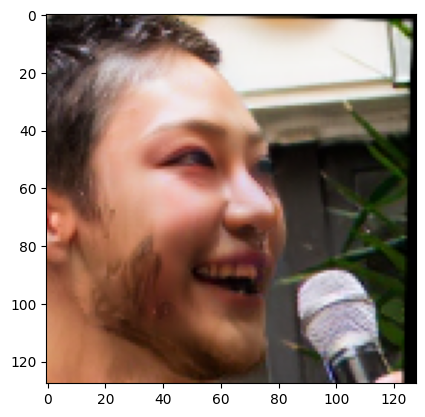

execution speed 25.92254


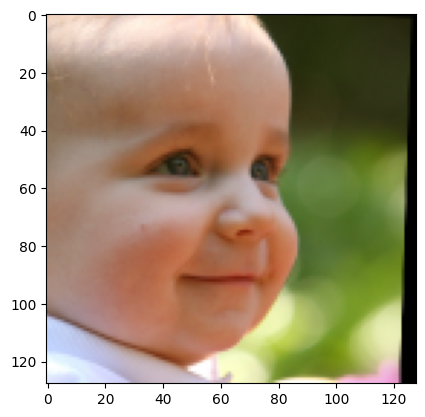

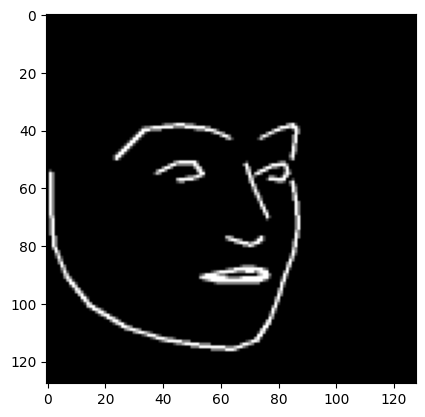

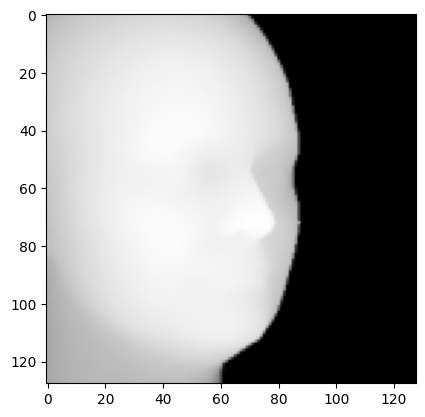

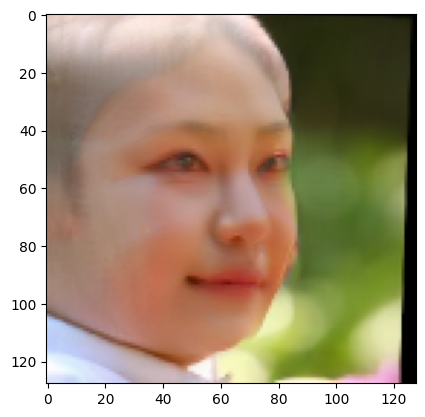

./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
execution speed 35.92515


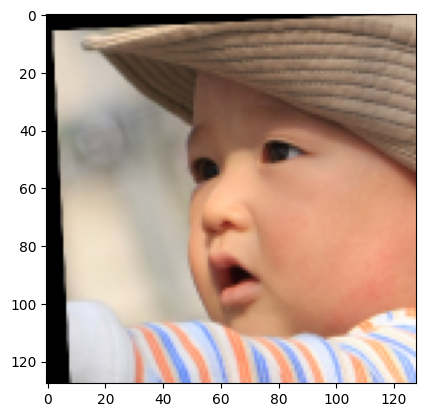

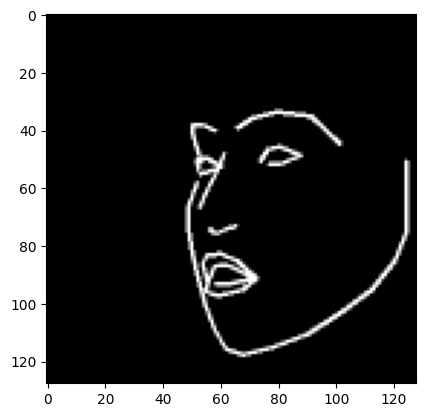

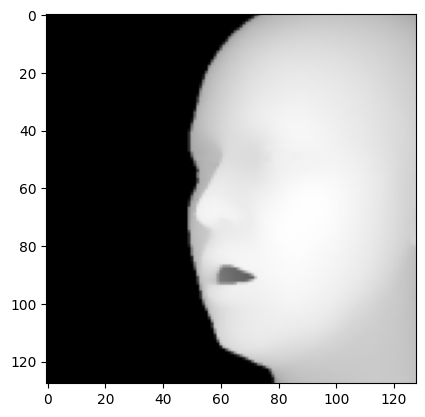

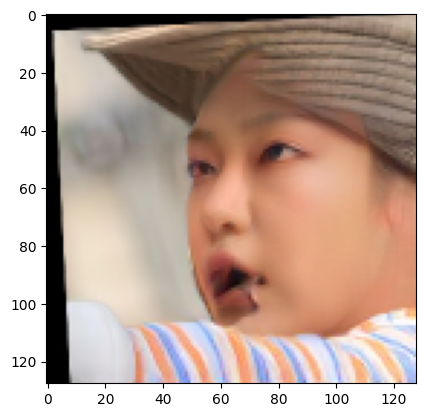

./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 22.37248


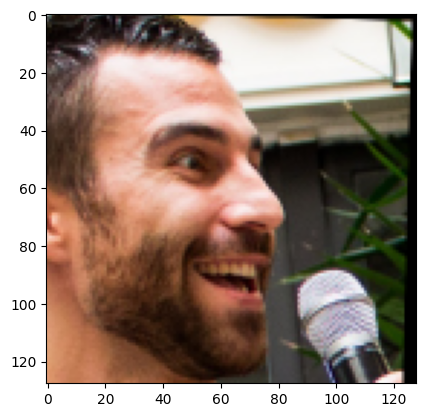

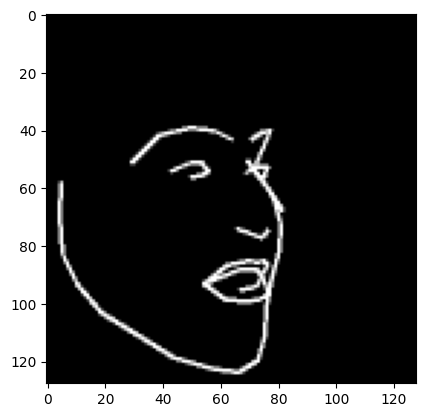

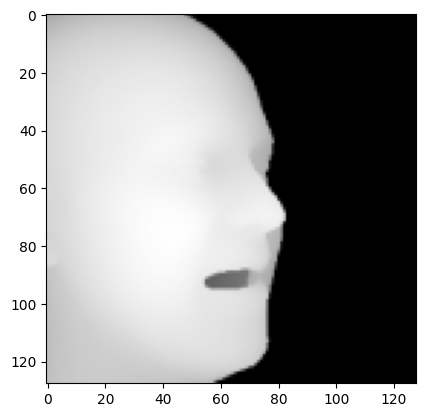

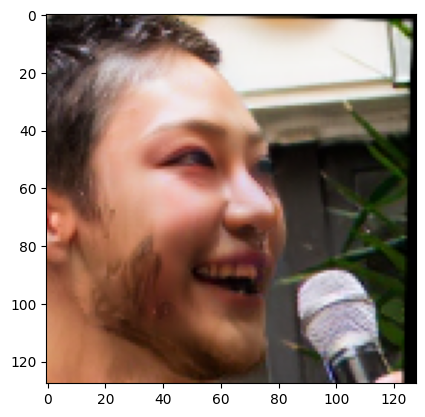

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 21.94142


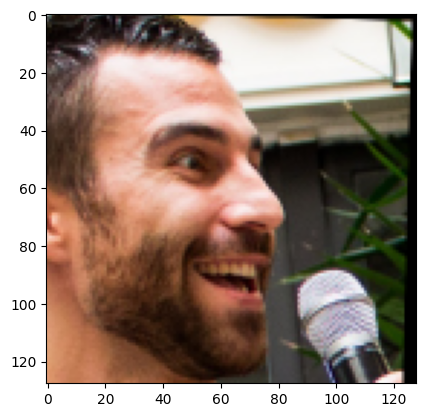

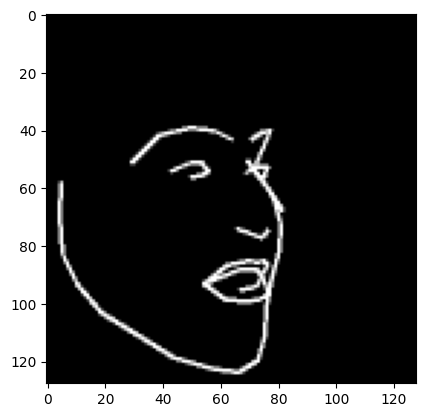

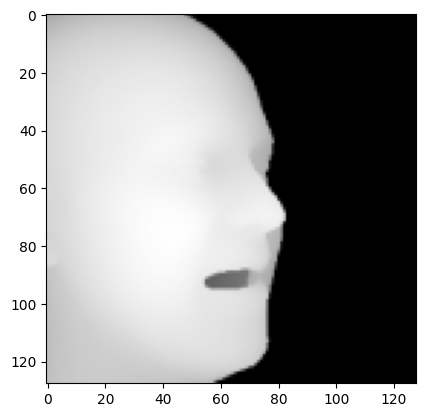

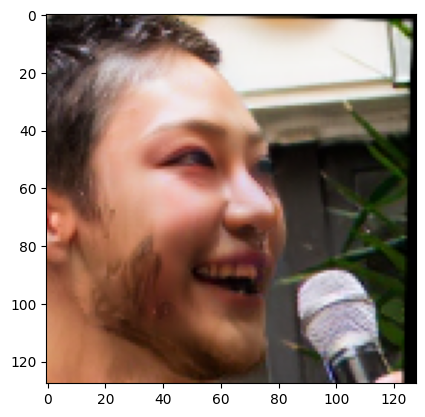

execution speed 19.74988


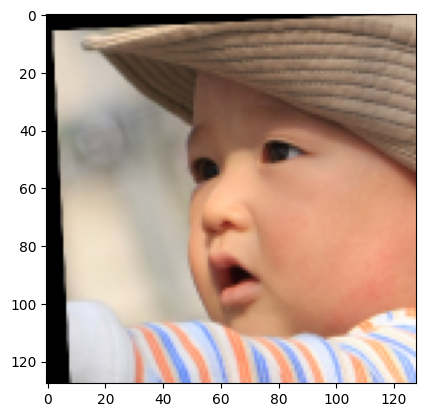

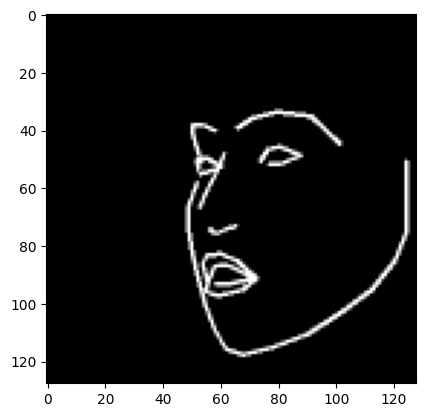

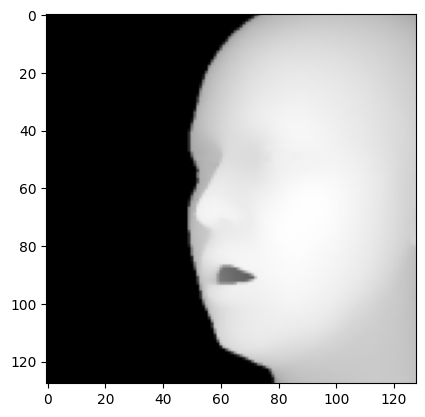

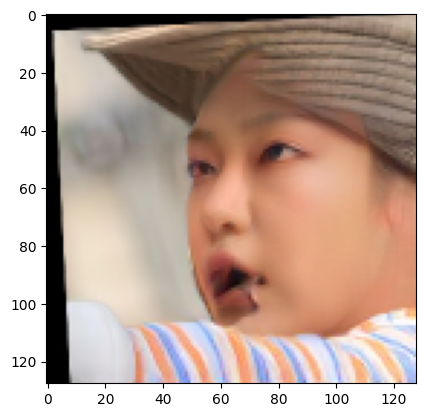

execution speed 22.51911


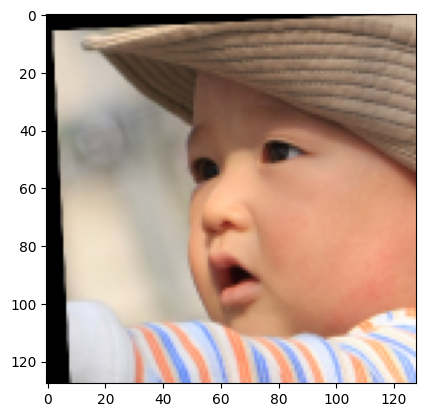

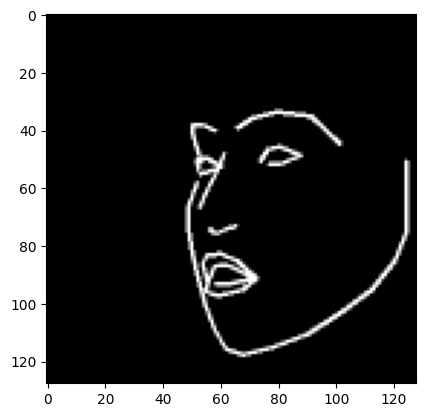

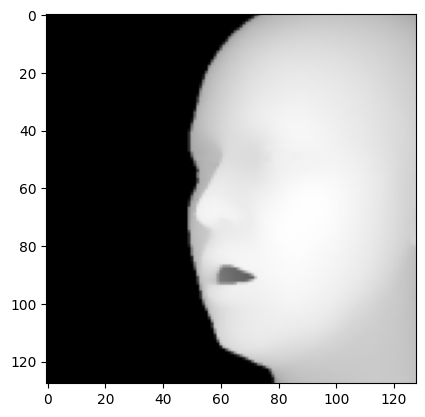

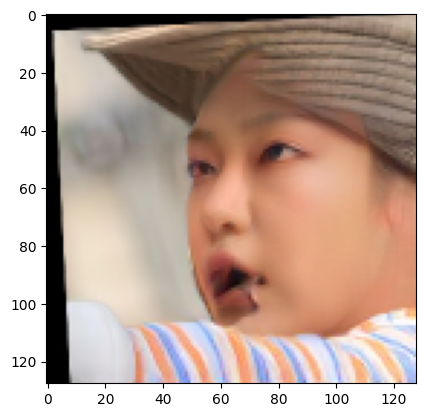

./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
execution speed 38.52034


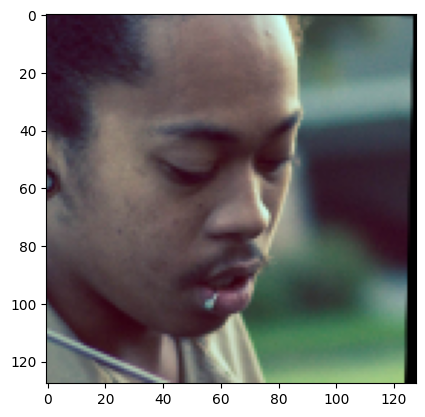

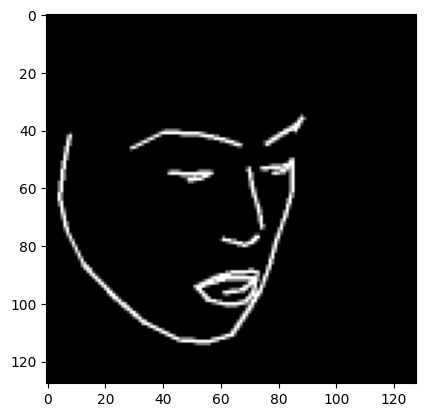

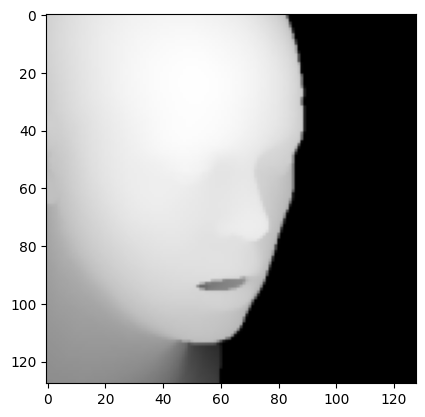

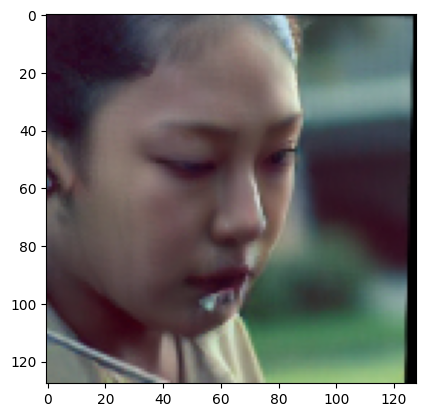

./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 24.18017


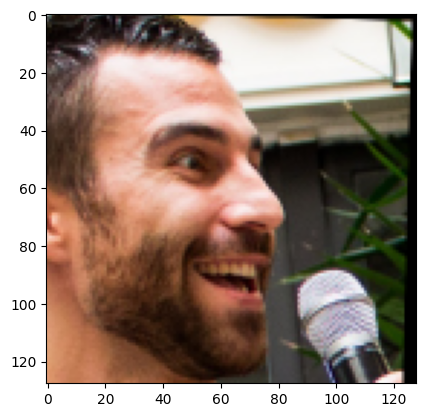

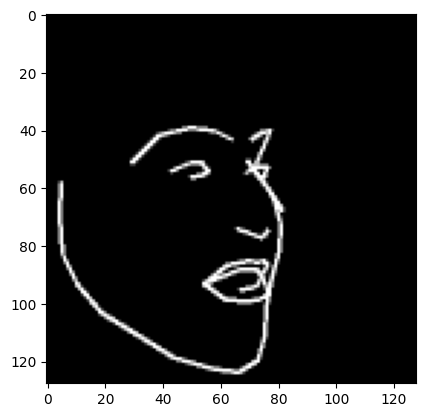

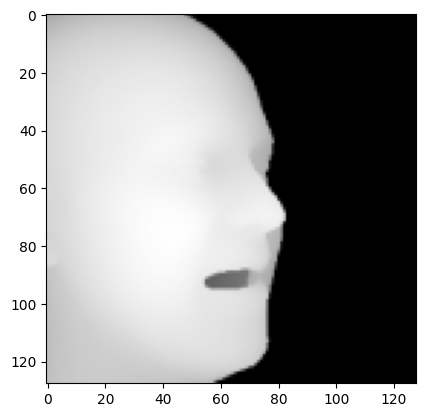

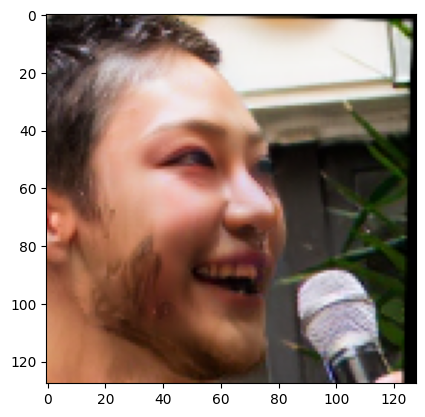

./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
execution speed 21.57307


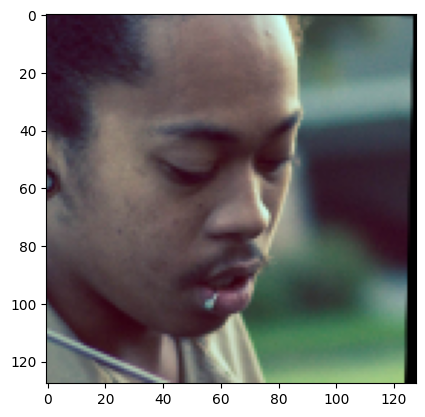

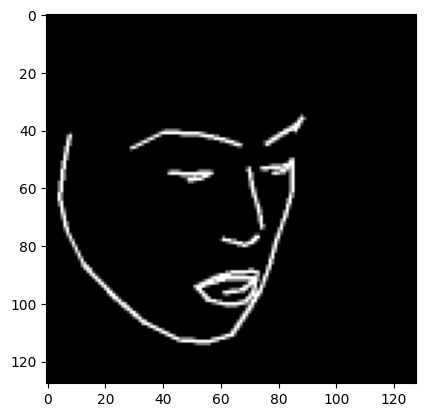

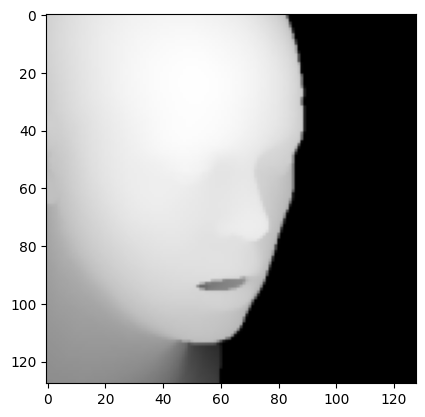

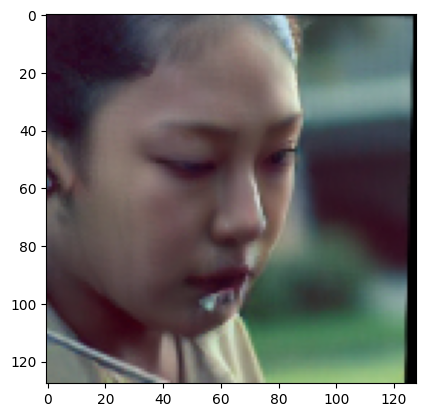

execution speed 20.17879


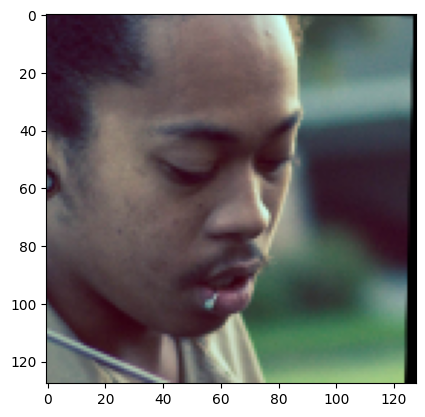

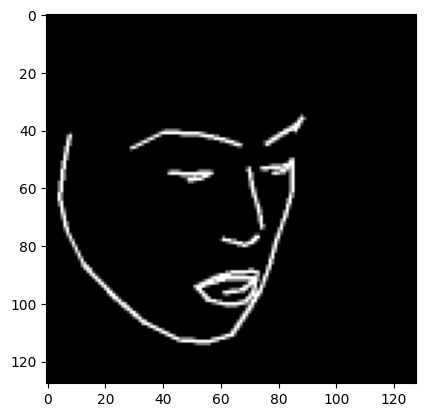

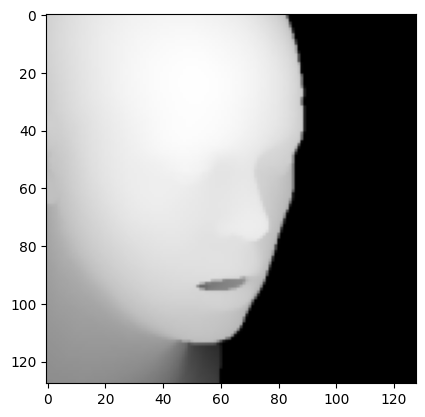

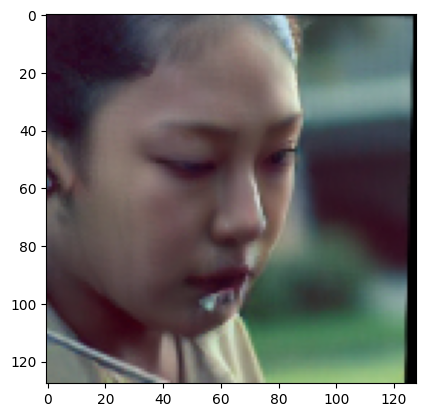

execution speed 18.78357


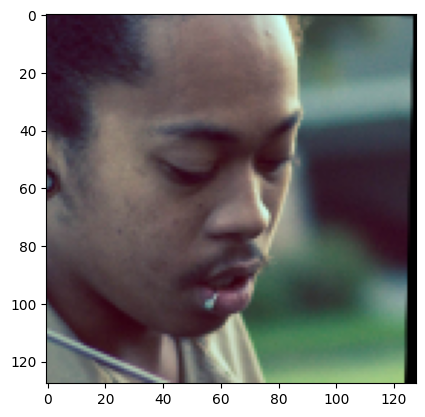

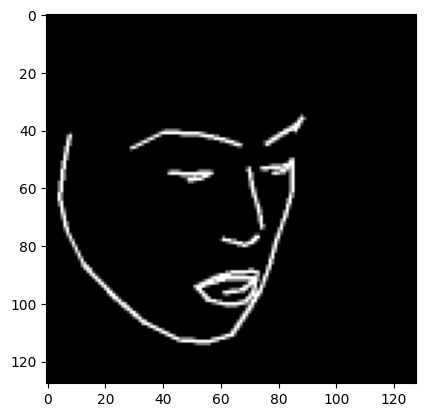

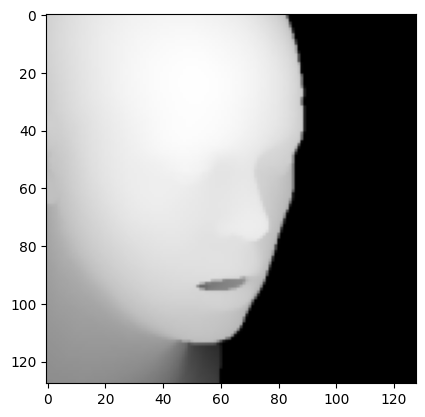

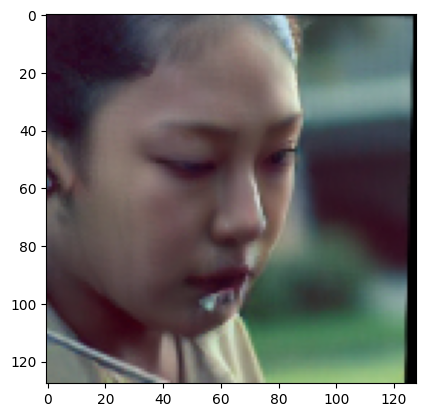

./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
execution speed 35.98952


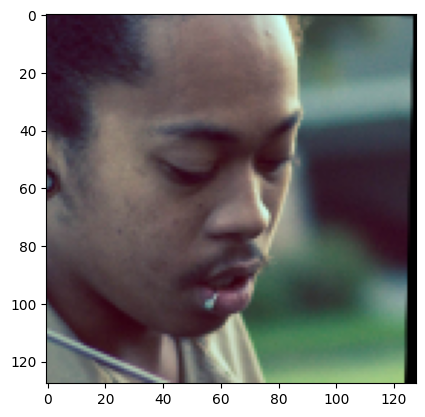

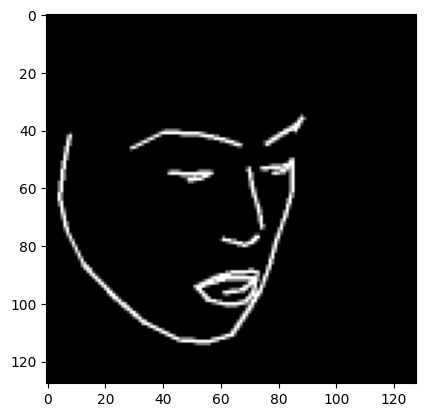

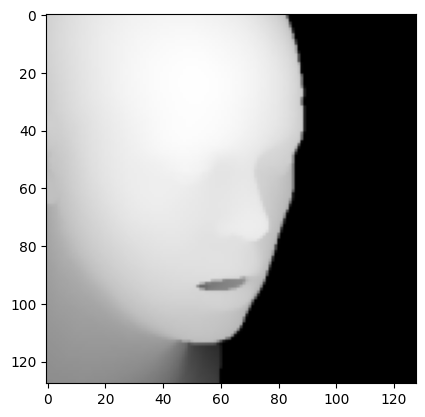

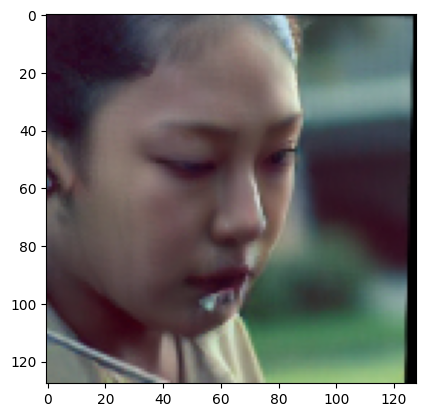

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 23.44847


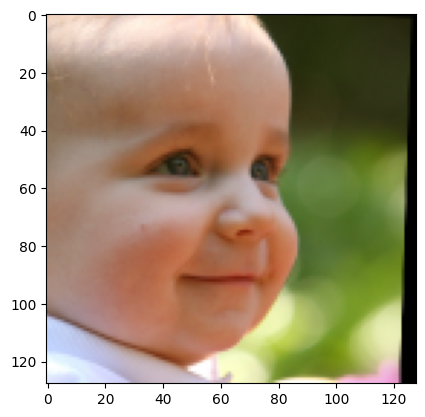

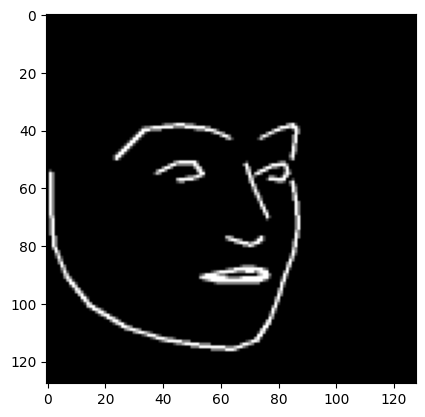

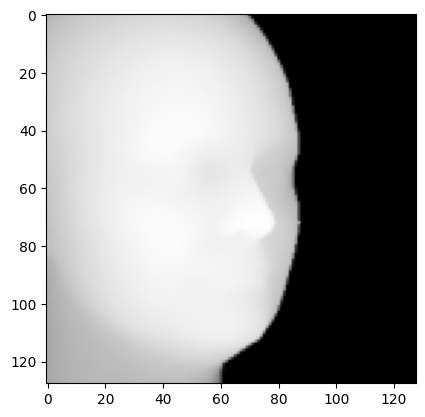

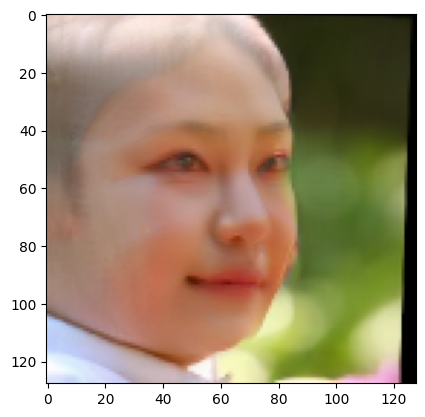

./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
execution speed 22.66788


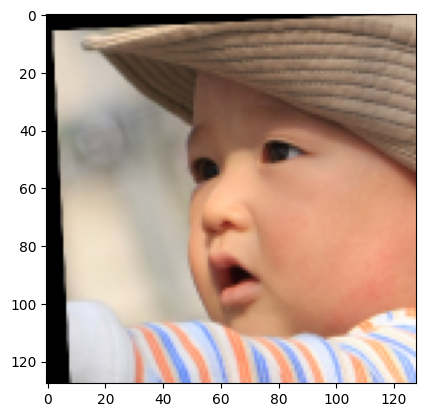

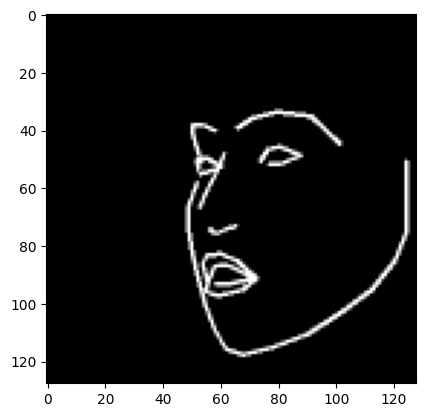

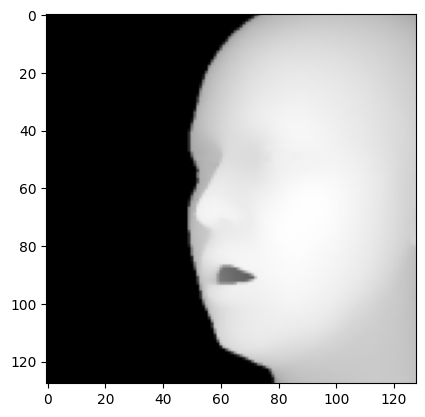

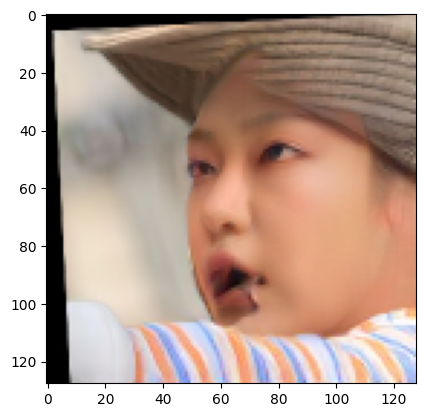

execution speed 18.91136


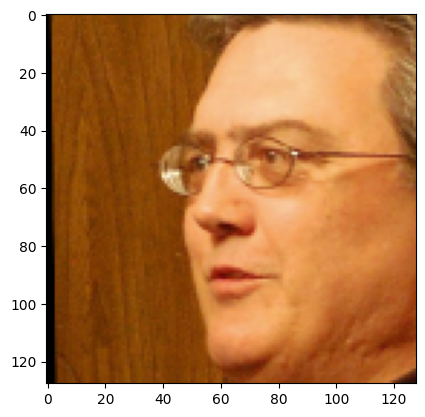

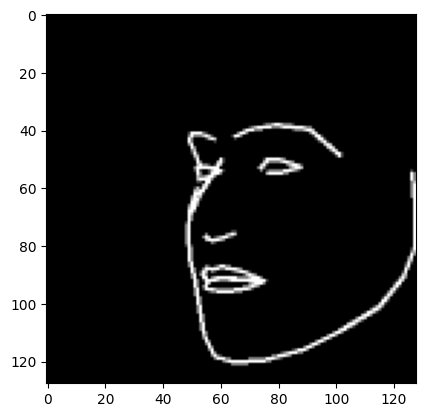

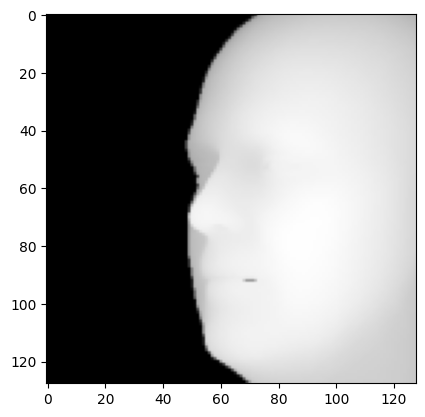

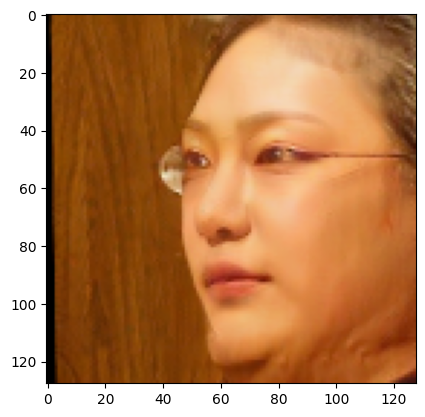

execution speed 21.76166


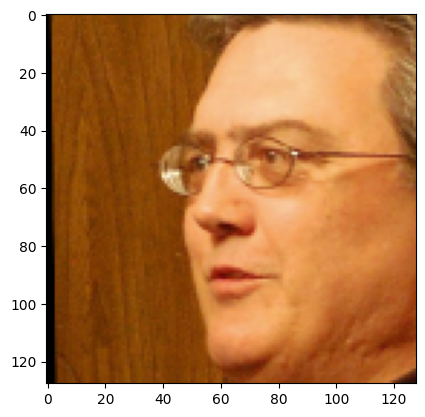

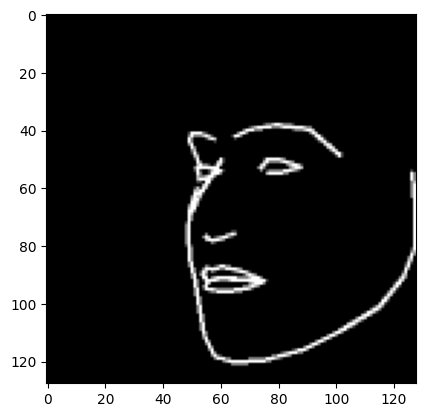

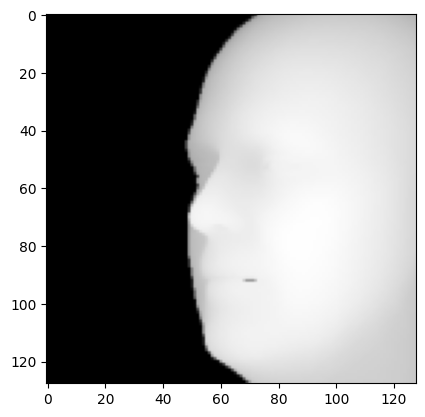

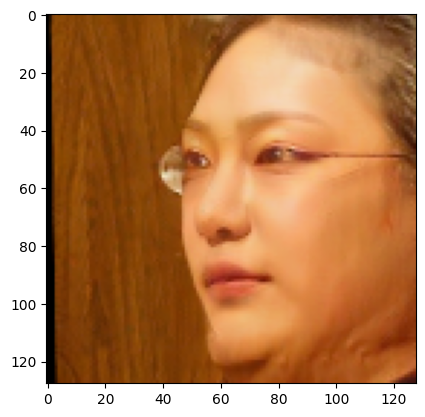

./dataset/LPFF_small/test_lpff/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff_mask_images/7466314@N05_3156416692_02.png
./dataset/LPFF_small/test_lpff/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff_mask_images/7301623@N06_6978627098_01.png
./dataset/LPFF_small/test_lpff/7226683@N03_15483260941_02.png
./dataset/LPFF_small/test_lpff_mask_images/7226683@N03_15483260941_02.png
execution speed 31.91900


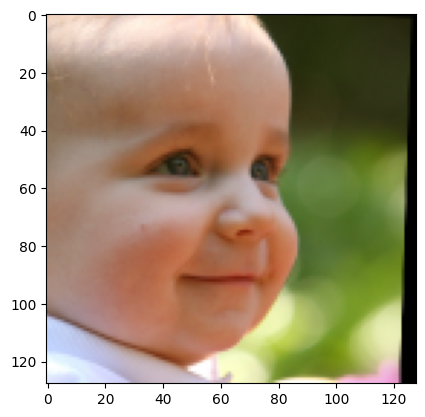

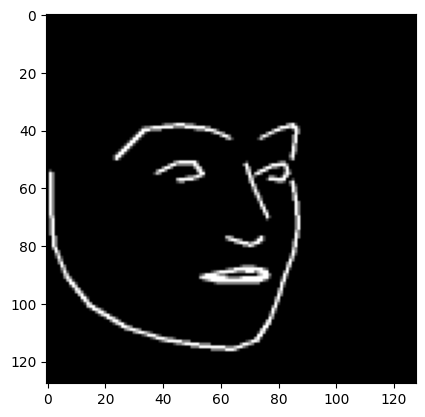

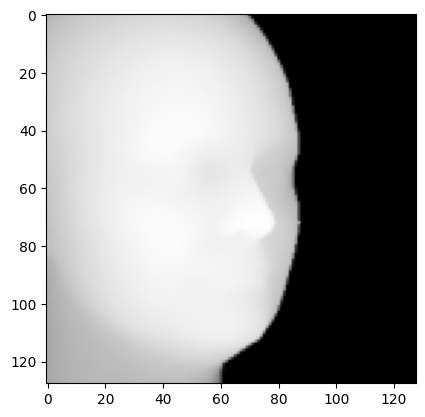

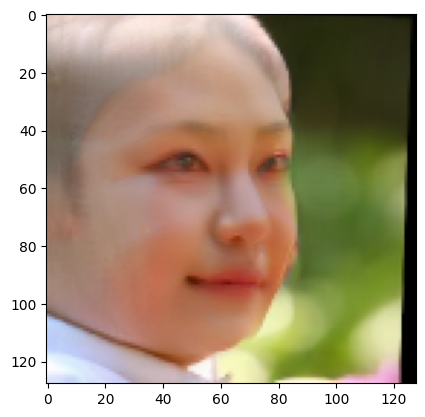

./dataset/LPFF_small/test_lpff/8225414@N05_3177600726_01.png
./dataset/LPFF_small/test_lpff_mask_images/8225414@N05_3177600726_01.png
execution speed 23.41390


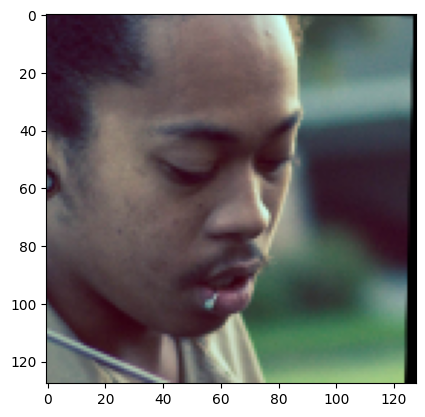

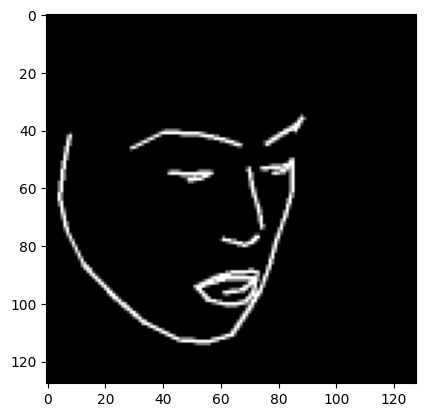

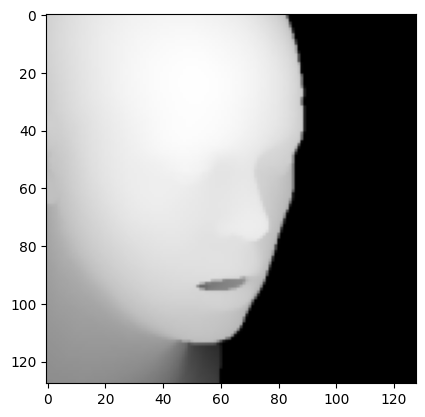

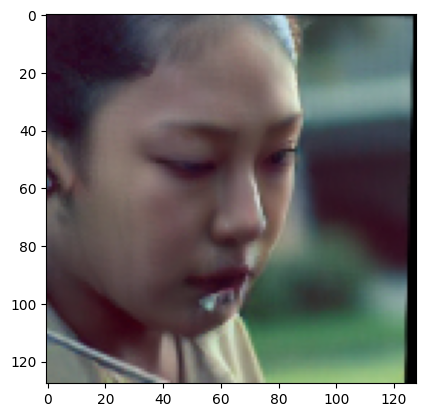

./dataset/LPFF_small/test_lpff/7972895@N02_7975594000_01.png
./dataset/LPFF_small/test_lpff_mask_images/7972895@N02_7975594000_01.png
execution speed 26.19028


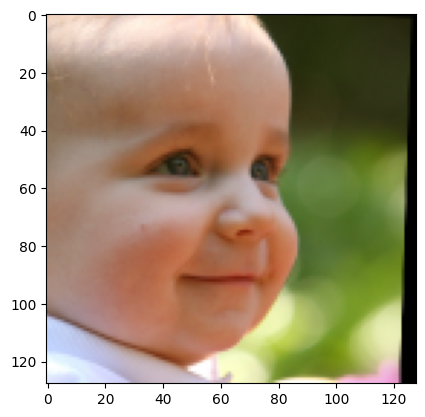

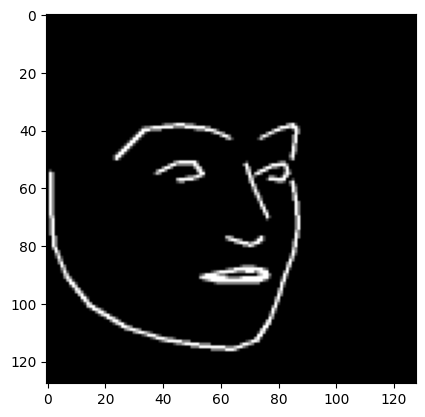

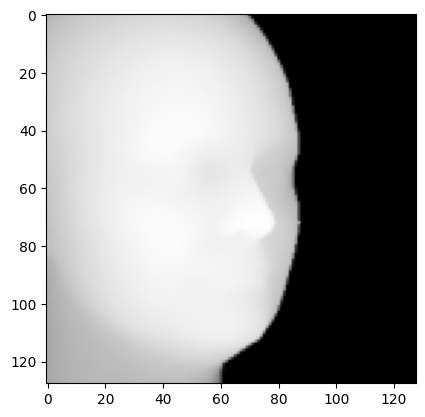

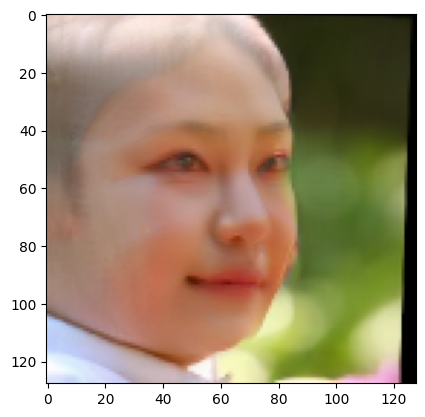

execution speed 18.33963


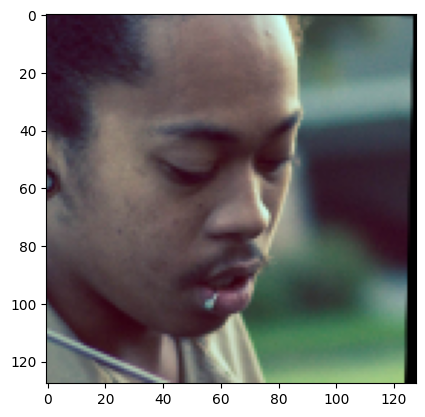

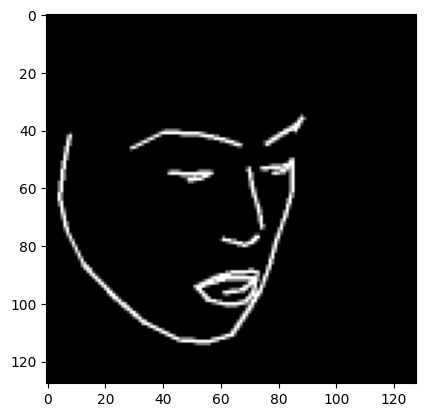

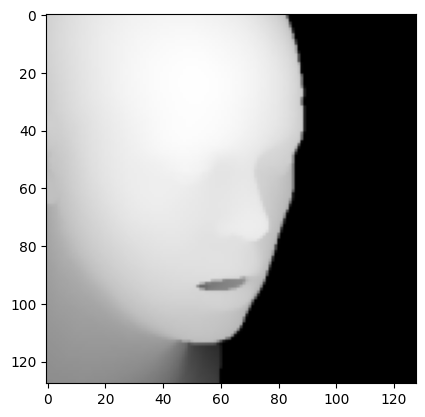

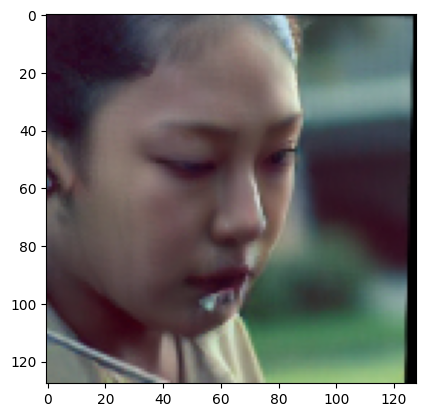

execution speed 17.76457


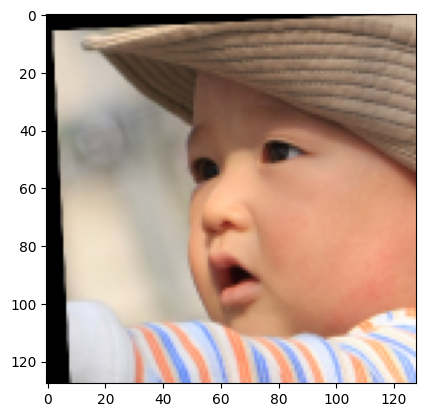

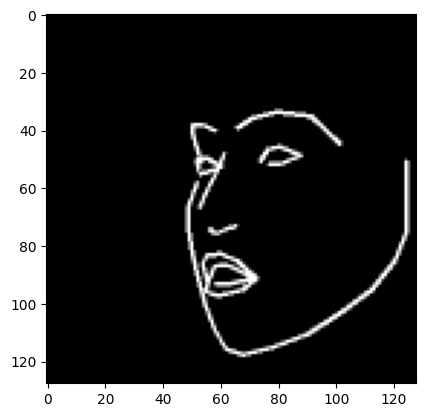

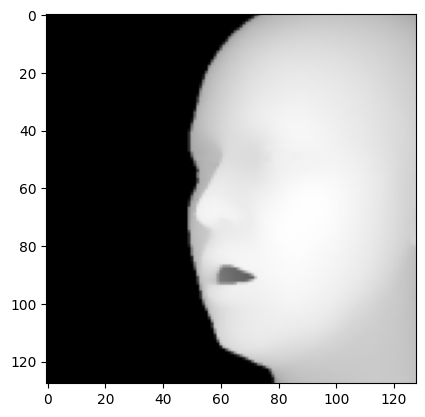

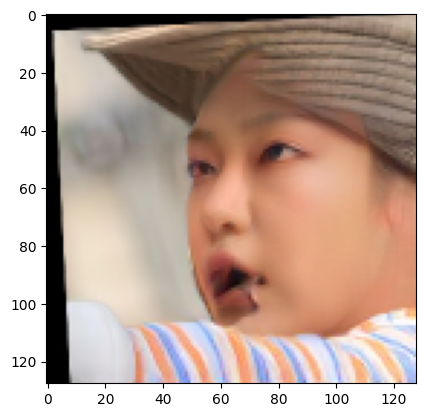

average execution speed time: 30.775228


In [3]:
if __name__ == '__main__':
    #TBD
    main()
